# Authors:
- Guijas Bravo, Pedro
- Miguélez Millos, Ángel

# 1. Preliminary Research

In this first section we will briefly introduce **Variational Autoencoders (VAEs)**, one of the most widely used deep learning methods for face image generation. Note the existence of another Nootebook in which **Generative Adversarial Networks (GANs)** will be specifically discussed, as well as a comparison between methods.

## Variational Autoencoders (VAEs)

### Introduction - AutoEncoders (AE)
Before diving into Variational Autoencoders (VAEs), it's important to first understand Autoencoders (AEs). AEs are neural networks that can learn to compress and decompress data, similar to VAEs. However, AEs don't explicitly model the underlying probability distribution of the data, making it difficult to generate new samples from the learned latent space. AEs are trained to minimize the reconstruction error between the input and output data, and can be used for tasks such as data compression, denoising, and anomaly detection.



### Architecture
VAEs are generative models based on neural networks that learn to encode high-dimensional data into a lower-dimensional latent space and decode it back into the original data space. The architecture of a VAE, like an AE, consists of three major elements. A coding network that seeks to compress the information by mapping the input data to a latent distribution. The bottleneck, which is where the compressed information is contained. And finally a decoding network that reassigns the latent variables to the data space.

However, as mentioned, AEs are trained to minimize the reconstruction error, not to organize the latent space. Thus, in AEs it happens that given a random point in the latent space, a decoding of something meaningful is not guaranteed. Therefore, for VAEs we will seek to introduce properties in the latent space in order to search for generative capabilities in the model.

For this, instead of encoding inputs as single points, they will be encoded as probability distributions over the latent space (multivariate Gaussian). Subsequently a point will be sampled from this distribution to be decoded, computing the reconstruction error and backpropagating the error over the network. It is also worth mentioning the use of KL divergences as regularization term to guarantee the distribution to a Normal(0,1).

In addition, it is important to mention that in the backpropagation process, since there is a sampling, it is not possible to perform it. Thus, a hidden state is introduced to allow it, which is known as the reparametrization trick. In addition to error propagation, this allows continuity, since 2 points with similar distributions in the latent space will be regenerated as similar contents. It will also allow a random point to have meaning, this being one of the greater advantages over simple AEs.

![ae-vae](https://data-science-blog.com/wp-content/uploads/2022/04/variational-auto-encoder-image-encoding-decoding.png)


### Application

VAEs are widely used in generative tasks. Furthermore, although VAEs are designed as generative models, like AEs, VAEs are also used for tasks such as data compression and anomaly detection. Specifically, some of the most common applications of VAEs as generative models are:

- Image generation: VAEs are used to generate realistic and novel images. 
- Audio synthesis: VAEs are also used to generate new audio clips.
- Text generation: VAEs have been used to generate text, such as creating new text snippets or generating answers to questions.
- Product design: VAEs have also been applied to product design, such as clothing, furniture, or automobiles.

In summary, the VAE model is a powerful tool for generating new data that are similar to the input data. Its generative applications span fields such as image generation, audio synthesis, text generation and product design, among others. These applications allow exploring and creating new instances based on the learned distribution of the original dataset.

# 2. Initial setup

First we will configure the environment to have the necessary library dependencies loaded, the dataset (in case it is necessary to mount Google Drive) and finally we will include the definition of useful functions to be used during training (display, plot_compare_VAE, plot_metrics, linear_interpolation and plot_generated).

## Imports

In [ ]:
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
import glob
# from google.colab import drive
import numpy as np
import numpy
from numpy import cov
from numpy import trace
from numpy import iscomplexobj
from numpy import asarray
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.optimizers.legacy import Adam
from tensorflow.python.framework.ops import disable_eager_execution
disable_eager_execution()
from keras import backend as K
from keras import callbacks 
from keras.layers import Input, Conv2D, Flatten, Dense, Conv2DTranspose, Reshape, Lambda, Activation, BatchNormalization, LeakyReLU, Dropout, add
from keras.models import Model
from keras.preprocessing.image import ImageDataGenerator
from keras.utils.vis_utils import plot_model
from scipy.linalg import sqrtm
from skimage.transform import resize
from keras.applications.inception_v3 import InceptionV3
from keras.applications.inception_v3 import preprocess_input

## Load DS Files from Drive 

In [ ]:
# Load from Drive
# drive.mount('/content/drive')
# !unzip -q -o /content/drive/MyDrive/datasets/celebfaces.zip -d .

## Useful Functions

In [ ]:
def display(images, dom=[0,1], size=(20, 3), cmap="viridis", as_type="float32", save_to=None):
    assert images.max() <= 1.0, "Found pixel value higher than 1.0!"
    assert images.min() >= 0.0, "Found pixel value lower than 0.0!"

    plt.figure(figsize=size)
    for i in range(images.shape[0]):
        _ = plt.subplot(1, images.shape[0], i + 1)
        plt.imshow(images[i].astype(as_type), cmap=cmap)
        plt.axis("off")

    if save_to:
        plt.savefig(save_to)
        print(f"\nSaved to {save_to}")

    plt.show()


def plot_compare_VAE(images, encoder, decoder, add_noise=False, cmap='viridis'):
    n_to_show = images.shape[0]
    if add_noise:
        encodings = encoder.predict(images)
        encodings += np.random.normal(0.0, 1.0, size=(n_to_show, 200))
        reconst_images = decoder.predict(encodings)
    else:
        reconst_images = decoder.predict(encoder.predict(images))

    fig = plt.figure(figsize=(12, 3))
    fig.subplots_adjust(left=0.05, bottom=0.05, right=0.95, top=0.95, hspace=0.1, wspace=0.1)

    for i in range(n_to_show):
        img = images[i]
        sub = fig.add_subplot(2, n_to_show, i+1)
        sub.axis('off')        
        sub.imshow(img, cmap=cmap)

    for i in range(n_to_show):
        img = reconst_images[i].squeeze()
        sub = fig.add_subplot(2, n_to_show, i+n_to_show+1)
        sub.axis('off')
        sub.imshow(img, cmap=cmap)

    plt.show()


def plot_metrics(history):
    for m_name, values in history.items():
      x = range(len(values))
      ax = plt.subplot(1,1,1)
      plt.plot(x, values, label=m_name)
      ax.set(xlabel="Epochs", ylabel=m_name)
      ax.legend()
      plt.show()


def linear_interpolation(img1, img2, encoder, decoder, steps=10):
    # Plot
    fig = plt.figure(figsize=(12, 3))
    fig.subplots_adjust(left=0.05, bottom=0.05, right=0.95, top=0.95, hspace=0.1, wspace=0.1)

    # Image 1
    left = img1
    img=left.squeeze()
    sub = fig.add_subplot(2, steps, 1)
    sub.axis('off')        
    sub.imshow(img)

    # Image 2
    right = img2
    img=right.squeeze()
    sub = fig.add_subplot(2, steps, steps)
    sub.axis('off')        
    sub.imshow(img)

    # Generate Image Encodings
    limit_encodings = encoder.predict(np.array([img1,img2]))

    # Generate Interpolations
    interp_encodings = np.zeros((steps, limit_encodings.shape[1]))
    # Bound Images
    interp_encodings[0] = limit_encodings[0]
    interp_encodings[-1] = limit_encodings[-1]
    # Intermediate Representations
    step_size = 1 / (interp_encodings.shape[0] - 1)
    for i in range(1, interp_encodings.shape[0] - 1):
        interpolation_factor = i * step_size
        interp_encodings[i] = (1 - interpolation_factor) * limit_encodings[0] + interpolation_factor * limit_encodings[-1]

    # Generate Model Reconstructions
    interp_images = decoder.predict(interp_encodings)
    
    # Plot results
    for i in range(steps):
            img = interp_images[i].squeeze()
            sub = fig.add_subplot(2, steps, steps+i+1)
            sub.axis('off')        
            sub.imshow(img) # PONER VIRDIA CMAP EN CASo DE QUE SE BUGUEÉ
    plt.show()


def plot_generated(decoder, latent_dim, n=10, cmap='viridis'):
    # Generate Images
    latent_points = np.random.normal(0.0, 1.0, size=(n * n, latent_dim))
    generated_images = decoder.predict(latent_points)

    # Plot
    fig = plt.figure(figsize=(12, 12))
    fig.subplots_adjust(left=0.05, bottom=0.05, right=0.95, top=0.95, hspace=0.1, wspace=0.1)

    for i in range(n * n):
        img = generated_images[i].squeeze()
        sub = fig.add_subplot(n, n, i+1)
        sub.axis('off')        
        sub.imshow(img, cmap=cmap)

    plt.show()

# 3. Data Preprocessing

Next, we will indicate the dataset paths as well as load the initial data set (data flows in this case). We also define parameters related to image loading such as `IMAGE_SIZE`, `CHANNELS`, `BATCH_SIZE` and `Z_DIM`.

Note that for the second execution, derived from the change of parameters, the dataset will be reloaded.

In [ ]:
# Get dataset .jpg images
DATA_FOLDER = "/content/img_align_celeba/"
DATA_FOLDER = "img_align_celeba/"
filenames = np.array(glob.glob(os.path.join(DATA_FOLDER, '*/*.jpg')))
NUM_IMAGES = len(filenames)
print("Total number of images : " + str(NUM_IMAGES))

Total number of images : 202599


In [ ]:
# Constants
IMAGE_SIZE = 32
CHANNELS = 3
BATCH_SIZE = 64
Z_DIM = 128  

# Generator that creates batches of rgb images in the range [0,1]
data_flow = ImageDataGenerator(rescale=1./255).flow_from_directory(
    DATA_FOLDER, 
    target_size=(IMAGE_SIZE,IMAGE_SIZE),
    batch_size=BATCH_SIZE,
    shuffle=True,
    class_mode='input', 
    color_mode='rgb',
    interpolation='bilinear'
)

Found 202599 images belonging to 1 classes.


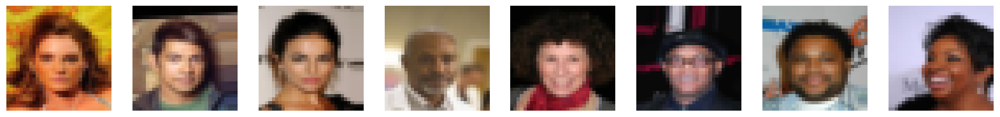

In [ ]:
data_samples_examples = next(data_flow)[0][:8]
display(data_samples_examples, cmap='viridis')

# 3. Create Model and Train  - (VAE only)

In this section, first of all, functions will be defined to allow the parameterized creation of the VAE components. These functions will be `build_vae_encoder`, `build_decoder`.

In addition, specific error functions (use of KL Div) and callbacks such as model checkpoints, generated image plots for visual analysis of model quality evolution and FID metrics computation will be defined. The latter has been included as a callback because it requires a considerable amount of computation, being unfeasible to introduce it as a metric to be computed in each training step.

Finally, in this section 2 experiments will be run. These will be analyzed and justified in their corresponding subsection.

Additionally, note the parameterization allowed by the create_model function.

## Model Architecture


In [ ]:
############## 
# ENCODER
############## 

def build_vae_encoder(input_dim, output_dim, conv_filters, conv_kernel_size, conv_strides, use_dropout=False, use_residual=False):
  
    # Clear tensorflow session to reset layer index numbers to 0
    global K
    K.clear_session()
    
    # Number of Conv layers
    n_layers = len(conv_filters)

    # Define model input
    encoder_input = Input(shape=input_dim, name='encoder_input')
    x = encoder_input

    # Add convolutional layers
    for i in range(n_layers):
        x = Conv2D(
              filters=conv_filters[i], 
              kernel_size=conv_kernel_size[i],
              strides=conv_strides[i], 
              padding='same',
              name='encoder_conv_' + str(i)
            )(x)
        x = LeakyReLU()(x)

        # Use dropout
        if (use_dropout and i > 0):  
          x = Dropout(0.3)(x)

        # Use skip connections
        if (use_residual):

          if (i > 0):
            residual = Conv2D(
              filters=conv_filters[i], 
              kernel_size=1,
              strides=conv_strides[i], 
              padding='same',
              name='encoder_residual_' + str(i)
            )(residual)
            x = add([x, residual])

          residual = x
        
    # Required for reshaping latent vector while building Decoder
    shape_before_flattening = K.int_shape(x)[1:] 
    
    # Encoder output
    x = Flatten()(x)
    mean_mu = Dense(output_dim, name='mu')(x)
    log_var = Dense(output_dim, name='log_var')(x)

    # Defining a function for sampling
    def sampling(args):
        mean_mu, log_var = args
        epsilon = K.random_normal(shape=K.shape(mean_mu), mean=0., stddev=1.) 
        return mean_mu + K.exp(log_var/2) * epsilon   

    # Keras Lambda Layer to include the sampling function as a layer 
    encoder_output = Lambda(sampling, name='encoder_output')([mean_mu, log_var])

    return encoder_input, encoder_output, mean_mu, log_var, shape_before_flattening, Model(encoder_input, encoder_output)


############## 
# Decoder
############## 

def build_decoder(input_dim, shape_before_flattening, conv_filters, conv_kernel_size, conv_strides, use_bn=False, use_residual=False):

    # Number of Conv layers
    n_layers = len(conv_filters)

    # Define model input
    decoder_input = Input(shape=(input_dim,), name='decoder_input')

    # To get an exact mirror image of the encoder
    x = Dense(np.prod(shape_before_flattening))(decoder_input)
    x = Reshape(shape_before_flattening)(x)

    # Add convolutional layers
    for i in range(n_layers):
        x = Conv2DTranspose(
              filters=conv_filters[i], 
              kernel_size=conv_kernel_size[i],
              strides=conv_strides[i], 
              padding='same',
              name='decoder_conv_' + str(i)
            )(x)
        
        # Adding a sigmoid layer at the end to restrict the outputs 
        # between 0 and 1
        if i < n_layers - 1:

            # Use batch normalization
            if (use_bn):
              x = BatchNormalization(momentum=0.9)(x)

            x = LeakyReLU(0.2)(x)

            # Use skip connections
            if (use_residual):

              if (i > 0):
                residual = Conv2DTranspose(
                  filters=conv_filters[i], 
                  kernel_size=1,
                  strides=conv_strides[i], 
                  padding='same',
                  name='decoder_residual_' + str(i)
                )(residual)
                x = add([x, residual])

              residual = x

        else:
            x = Activation('sigmoid')(x)

    # Define model output
    decoder_output = x

    return decoder_input, decoder_output, Model(decoder_input, decoder_output)
    

## Loss Function and Training Callbacks

In [ ]:
######################################################################
# Loss Functions: Kl Div | Diffs between input and output | Total Loss
######################################################################

def r_loss(y_true, y_pred):
    return K.mean(K.square(y_true - y_pred), axis=[1,2,3])

def kl_loss(y_true, y_pred): 
    # use the log_var and mean_mu of the scope
    kl_loss = -0.5 * K.sum(1 + log_var - K.square(mean_mu) - K.exp(log_var), axis=1)
    return kl_loss

LOSS_FACTOR = 10000
def total_loss(y_true, y_pred):
    return LOSS_FACTOR * r_loss(y_true, y_pred) + kl_loss(y_true, y_pred)

##########################
# Show progress callback
##########################

class ImageGenerator(callbacks.Callback):
    def __init__(self, example_images, encoder, decoder):
        self.example_images = example_images
        self.encoder = encoder
        self.decoder = decoder

    def on_epoch_end(self, epoch, logs=None):
        plot_compare_VAE(self.example_images, self.encoder, self.decoder) 

##########################
# Checkpoint callback
##########################
model_checkpoint_callback = callbacks.ModelCheckpoint(
    filepath="./checkpoint/vae.ckpt",
    save_weights_only=True,
    save_freq="epoch",
    verbose=0,
)

##########################
# FID callback
##########################
class FIDCalculator(callbacks.Callback):
    def __init__(self, decoder, real_images, latent_dim):

      self.decoder = decoder

      self.inception_input_shape = (75, 75, 3)  # minimum size required by the Inception module
      self.inception = InceptionV3(include_top=False, pooling='avg', input_shape=self.inception_input_shape)
      
      self.num_img = real_images.shape[0]
      self.real_images = real_images
      self.real_images_preprocessed = self.preprocess(real_images)
      self.latent_dim = latent_dim
      self.log = []

    def preprocess(self, images):
      images = images.astype('float32')

      images_list = list()
      for image in images:
        new_image = resize(image, self.inception_input_shape, 0)
        images_list.append(new_image)
      images = asarray(images_list)

      # images = preprocess_input(images)  # they are supposed to be in the range [-1,1] already
      return images

    def compute_fid(self, real_images, generated_images):
      # calculate activations
      act1 = self.inception.predict(real_images, verbose=0)
      act2 = self.inception.predict(generated_images, verbose=0)

      # calculate mean and covariance statistics
      mu1, sigma1 = act1.mean(axis=0), cov(act1, rowvar=False)
      mu2, sigma2 = act2.mean(axis=0), cov(act2, rowvar=False)

      # calculate sum squared difference between means
      ssdiff = numpy.sum((mu1 - mu2)**2.0)

      # calculate sqrt of product between cov
      covmean = sqrtm(sigma1.dot(sigma2))

      # check and correct imaginary numbers from sqrt
      if iscomplexobj(covmean):
          covmean = covmean.real

      # calculate score
      fid = ssdiff + trace(sigma1 + sigma2 - 2.0 * covmean)
      return fid

    def on_epoch_end(self, epoch, logs=None):
        random_latent_vectors = tf.random.normal(shape=(self.num_img, self.latent_dim))
        generated_images = self.decoder.predict(random_latent_vectors, steps=1)
        generated_images = self.preprocess(generated_images)
        fid = self.compute_fid(self.real_images_preprocessed, generated_images)
        self.log.append(fid)
        print('FID: %.3f' % fid)

## Training

Unlike the GANs notebook, as in the learning process recreated images are shown, starting from an encoding of the latent space corresponding to a real image, purely generated images with random points of the latent space will be shown. This will allow a qualitative analysis of the generative capabilities of the model.

### Run 1

As a first execution, we will start from the supplied parameters. In other words, we will start from a symmetrical convolutional architecture both in the encoder and in the decoder that is not too deep. As for the images and the dimension of the latent space, we will also start from considerably small sizes.

Regarding the learning rate, a relatively low learning rate of 0.0005 has been used. In addition, 50 epochs will be executed, limiting the steps per epoch to 1500.

The aim of this initial run with a modest parameter configuration will be to analyze its behavior and try to improve it in the next experiment by using larger and more complex architectures.

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 encoder_input (InputLayer)     [(None, 64, 64, 3)]  0           []                               
                                                                                                  
 encoder_conv_0 (Conv2D)        (None, 32, 32, 16)   448         ['encoder_input[0][0]']          
                                                                                                  
 leaky_re_lu (LeakyReLU)        (None, 32, 32, 16)   0           ['encoder_conv_0[0][0]']         
                                                                                                  
 encoder_conv_1 (Conv2D)        (None, 16, 16, 32)   4640        ['leaky_re_lu[0][0]']            
                                                                                              

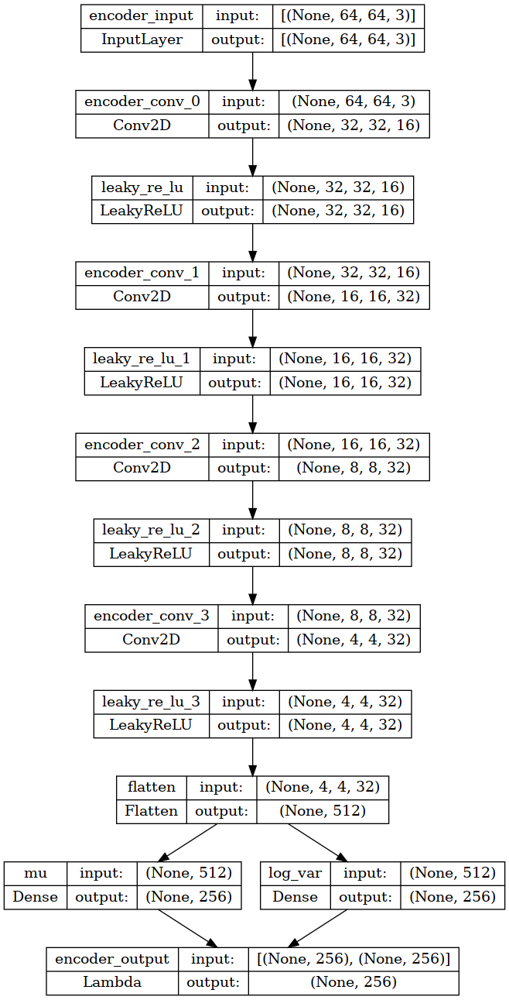

In [ ]:
################
# Encoder Init
################

vae_encoder_input, vae_encoder_output, mean_mu, log_var, vae_shape_before_flattening, vae_encoder = build_vae_encoder(
    input_dim=(IMAGE_SIZE,IMAGE_SIZE,CHANNELS),
    output_dim=Z_DIM, 
    conv_filters=[16, 32, 32, 32],
    conv_kernel_size=[3, 3, 3, 3],
    conv_strides=[2, 2, 2, 2],
    use_dropout=False,
    use_residual=False,
)
vae_encoder.summary()
plot_model(vae_encoder, show_shapes=True, show_layer_names=True)

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 decoder_input (InputLayer)  [(None, 256)]             0         
                                                                 
 dense (Dense)               (None, 512)               131584    
                                                                 
 reshape (Reshape)           (None, 4, 4, 32)          0         
                                                                 
 decoder_conv_0 (Conv2DTrans  (None, 8, 8, 32)         9248      
 pose)                                                           
                                                                 
 leaky_re_lu_4 (LeakyReLU)   (None, 8, 8, 32)          0         
                                                                 
 decoder_conv_1 (Conv2DTrans  (None, 16, 16, 32)       9248      
 pose)                                                     

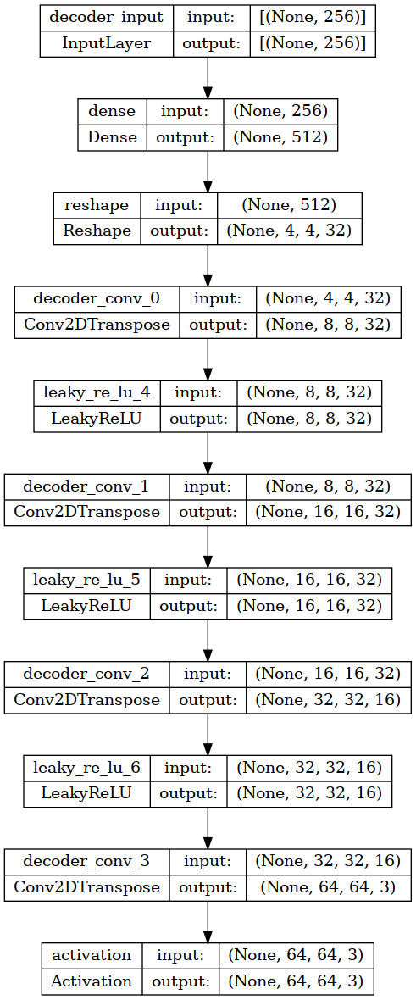

In [ ]:
################
# Decoder Init
################

decoder_input, decoder_output, vae_decoder = build_decoder(
    input_dim=Z_DIM,
    shape_before_flattening=vae_shape_before_flattening,
    conv_filters = [32, 32, 16, CHANNELS],
    conv_kernel_size = [3, 3, 3, 3],
    conv_strides = [2, 2, 2, 2],
    use_bn=False,
    use_residual=False
)
vae_decoder.summary()
plot_model(vae_decoder, show_shapes=True, show_layer_names=True)

In [ ]:
##########################
# Variational AutoEncoder
##########################

vae = Model(vae_encoder_input, vae_decoder(vae_encoder_output))
vae.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 encoder_input (InputLayer)     [(None, 32, 32, 3)]  0           []                               
                                                                                                  
 encoder_conv_0 (Conv2D)        (None, 16, 16, 16)   448         ['encoder_input[0][0]']          
                                                                                                  
 leaky_re_lu (LeakyReLU)        (None, 16, 16, 16)   0           ['encoder_conv_0[0][0]']         
                                                                                                  
 encoder_conv_1 (Conv2D)        (None, 8, 8, 32)     4640        ['leaky_re_lu[0][0]']            
                                                                                            

Epoch 1/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 63.9833 - loss: 222.0889 - r_loss: 0.0178 - kl_loss: 43.8160

/home/pedro/.local/lib/python3.9/site-packages/keras/engine/training_v1.py:2359: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates=self.state_updates,


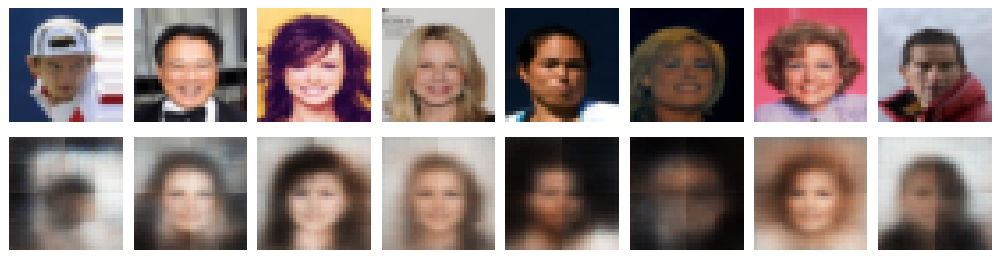

FID: 810.222
1500/1500 [==============================] - 71s 46ms/step - batch: 749.5000 - size: 63.9833 - loss: 222.0889 - r_loss: 0.0178 - kl_loss: 43.8160
Epoch 2/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 64.0000 - loss: 189.3033 - r_loss: 0.0146 - kl_loss: 43.4004

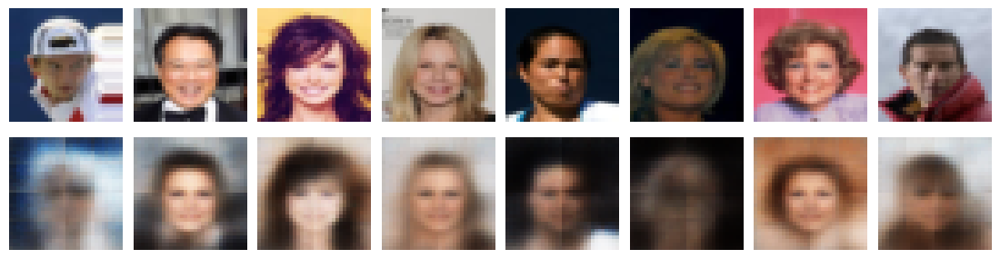

FID: 775.921
1500/1500 [==============================] - 66s 44ms/step - batch: 749.5000 - size: 64.0000 - loss: 189.2981 - r_loss: 0.0146 - kl_loss: 43.4010
Epoch 3/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 64.0000 - loss: 175.6745 - r_loss: 0.0132 - kl_loss: 43.7861

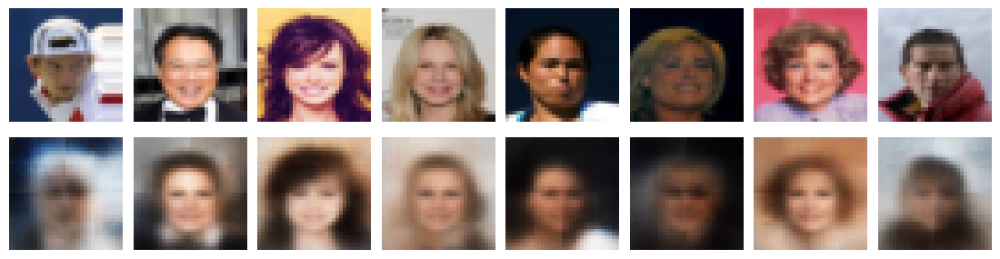

FID: 690.244
1500/1500 [==============================] - 63s 42ms/step - batch: 749.5000 - size: 64.0000 - loss: 175.6745 - r_loss: 0.0132 - kl_loss: 43.7861
Epoch 4/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 63.9833 - loss: 169.2904 - r_loss: 0.0125 - kl_loss: 44.1990

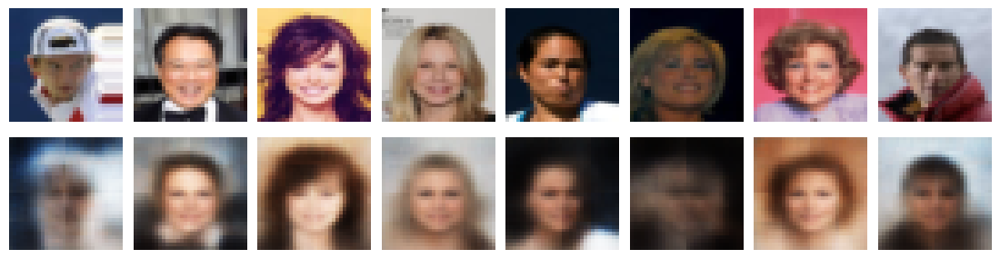

FID: 632.882
1500/1500 [==============================] - 59s 39ms/step - batch: 749.5000 - size: 63.9833 - loss: 169.2896 - r_loss: 0.0125 - kl_loss: 44.1995
Epoch 5/50
1498/1500 [============================>.] - ETA: 0s - batch: 748.5000 - size: 63.9833 - loss: 165.3679 - r_loss: 0.0121 - kl_loss: 44.8168

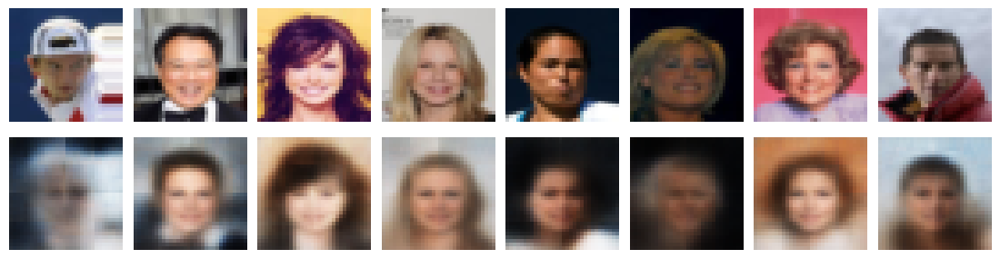

FID: 603.074
1500/1500 [==============================] - 57s 38ms/step - batch: 749.5000 - size: 63.9833 - loss: 165.3729 - r_loss: 0.0121 - kl_loss: 44.8189
Epoch 6/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 64.0000 - loss: 163.0087 - r_loss: 0.0118 - kl_loss: 45.4452

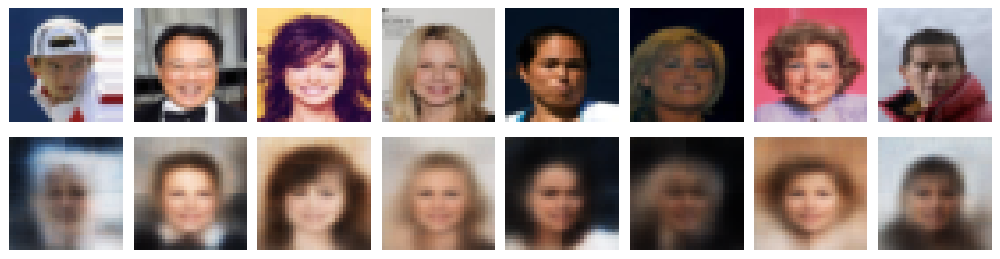

FID: 610.741
1500/1500 [==============================] - 60s 40ms/step - batch: 749.5000 - size: 64.0000 - loss: 163.0156 - r_loss: 0.0118 - kl_loss: 45.4464
Epoch 7/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 63.9833 - loss: 160.7226 - r_loss: 0.0115 - kl_loss: 45.8291

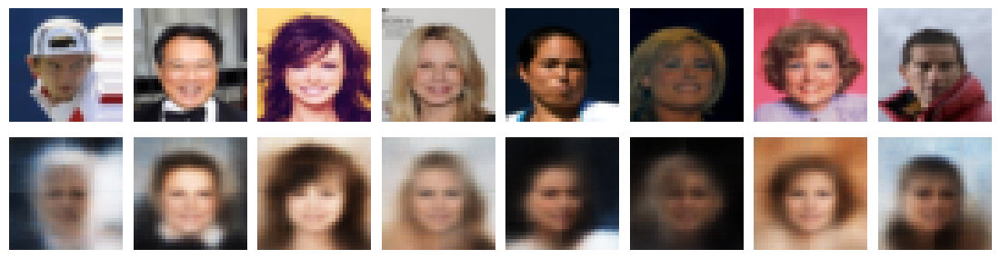

FID: 594.007
1500/1500 [==============================] - 57s 38ms/step - batch: 749.5000 - size: 63.9833 - loss: 160.7226 - r_loss: 0.0115 - kl_loss: 45.8291
Epoch 8/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 64.0000 - loss: 159.1617 - r_loss: 0.0113 - kl_loss: 46.1558

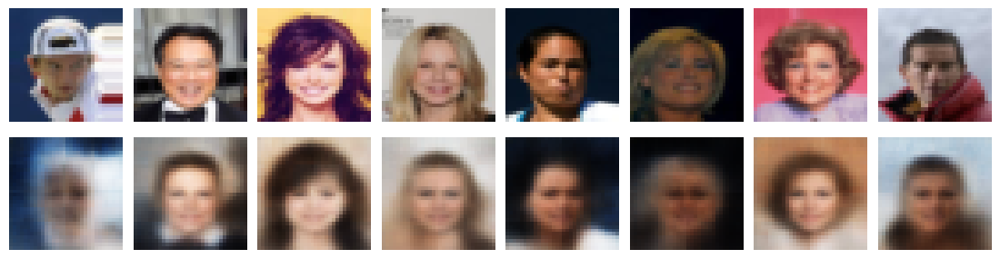

FID: 598.008
1500/1500 [==============================] - 58s 38ms/step - batch: 749.5000 - size: 64.0000 - loss: 159.1633 - r_loss: 0.0113 - kl_loss: 46.1568
Epoch 9/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 63.9833 - loss: 157.5541 - r_loss: 0.0111 - kl_loss: 46.3908

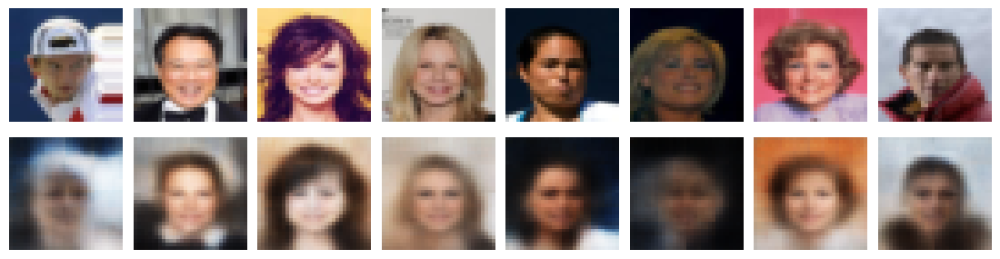

FID: 603.097
1500/1500 [==============================] - 57s 38ms/step - batch: 749.5000 - size: 63.9833 - loss: 157.5493 - r_loss: 0.0111 - kl_loss: 46.3905
Epoch 10/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 64.0000 - loss: 156.4872 - r_loss: 0.0110 - kl_loss: 46.6985

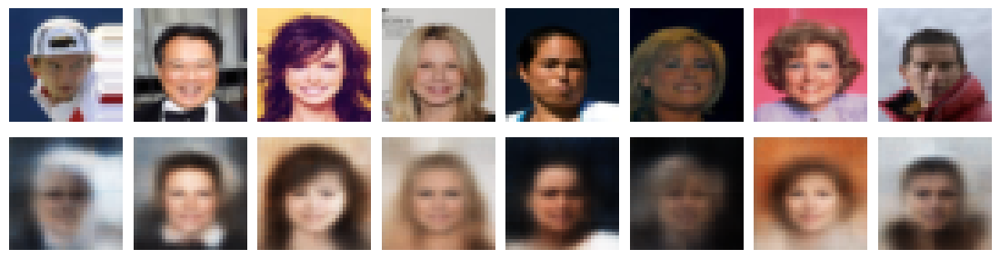

FID: 602.779
1500/1500 [==============================] - 56s 37ms/step - batch: 749.5000 - size: 64.0000 - loss: 156.4900 - r_loss: 0.0110 - kl_loss: 46.6991
Epoch 11/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 63.9833 - loss: 155.6097 - r_loss: 0.0109 - kl_loss: 46.9943

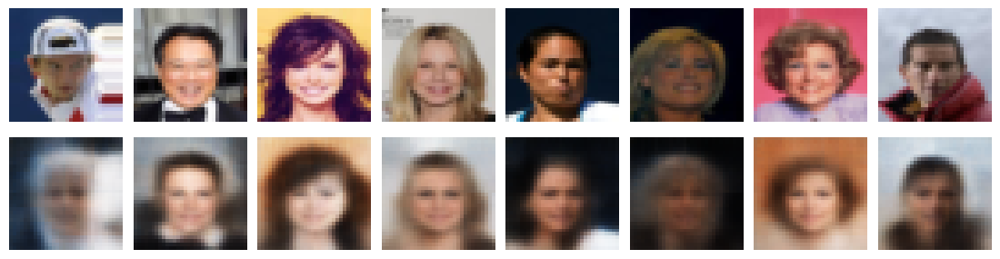

FID: 590.689
1500/1500 [==============================] - 59s 40ms/step - batch: 749.5000 - size: 63.9833 - loss: 155.6097 - r_loss: 0.0109 - kl_loss: 46.9943
Epoch 12/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 64.0000 - loss: 154.7542 - r_loss: 0.0108 - kl_loss: 47.2360

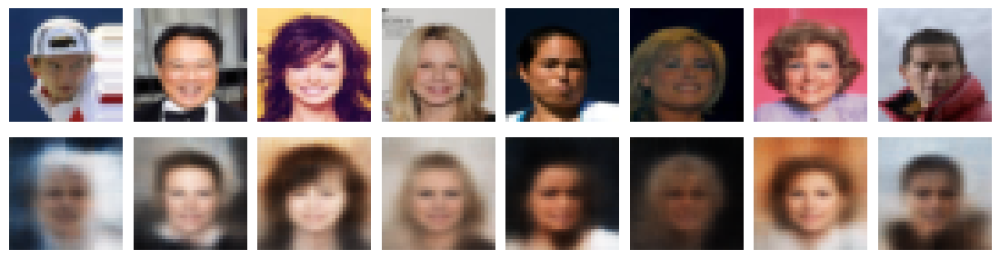

FID: 593.457
1500/1500 [==============================] - 56s 37ms/step - batch: 749.5000 - size: 64.0000 - loss: 154.7673 - r_loss: 0.0108 - kl_loss: 47.2377
Epoch 13/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 64.0000 - loss: 154.0388 - r_loss: 0.0106 - kl_loss: 47.6564

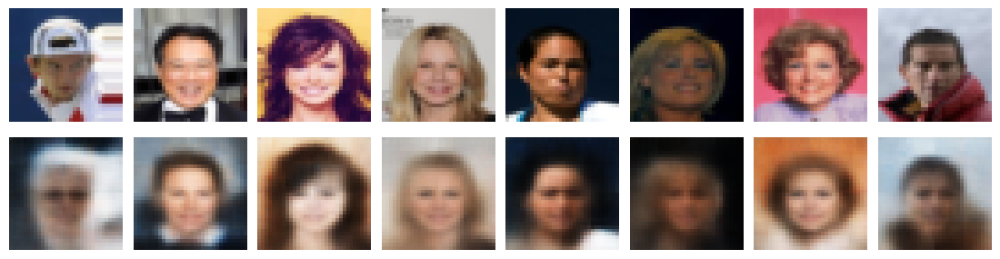

FID: 571.142
1500/1500 [==============================] - 56s 37ms/step - batch: 749.5000 - size: 64.0000 - loss: 154.0388 - r_loss: 0.0106 - kl_loss: 47.6564
Epoch 14/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 63.9833 - loss: 153.2408 - r_loss: 0.0105 - kl_loss: 47.9529

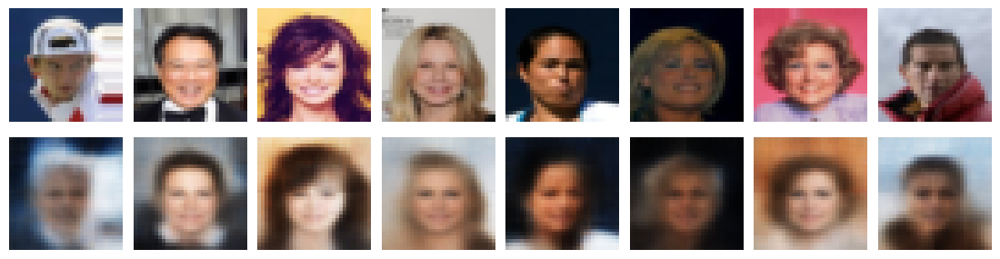

FID: 573.089
1500/1500 [==============================] - 60s 40ms/step - batch: 749.5000 - size: 63.9833 - loss: 153.2369 - r_loss: 0.0105 - kl_loss: 47.9520
Epoch 15/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 64.0000 - loss: 152.7107 - r_loss: 0.0104 - kl_loss: 48.2251

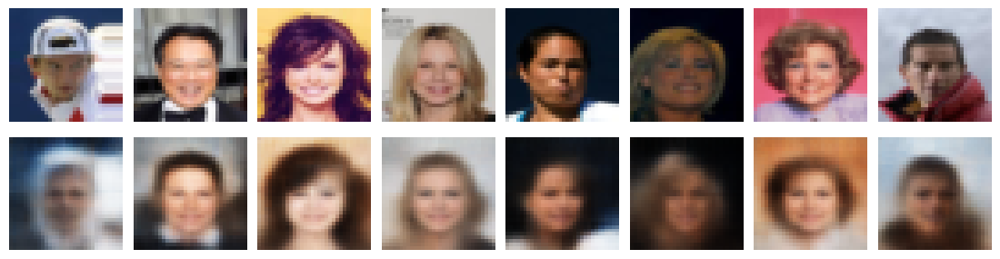

FID: 560.008
1500/1500 [==============================] - 56s 38ms/step - batch: 749.5000 - size: 64.0000 - loss: 152.7107 - r_loss: 0.0104 - kl_loss: 48.2251
Epoch 16/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 63.9833 - loss: 151.9130 - r_loss: 0.0103 - kl_loss: 48.4886

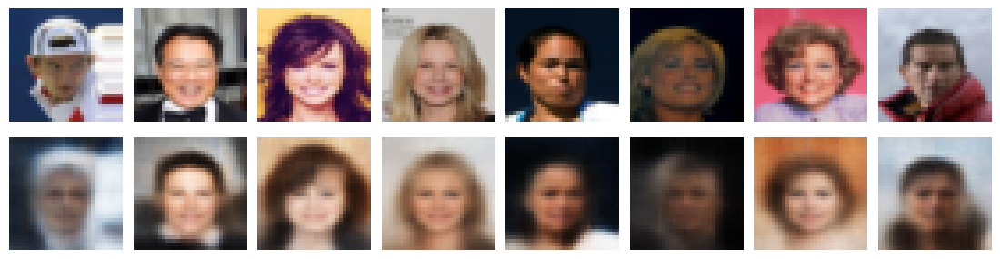

FID: 558.031
1500/1500 [==============================] - 55s 36ms/step - batch: 749.5000 - size: 63.9833 - loss: 151.9130 - r_loss: 0.0103 - kl_loss: 48.4886
Epoch 17/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 64.0000 - loss: 151.4808 - r_loss: 0.0103 - kl_loss: 48.6925

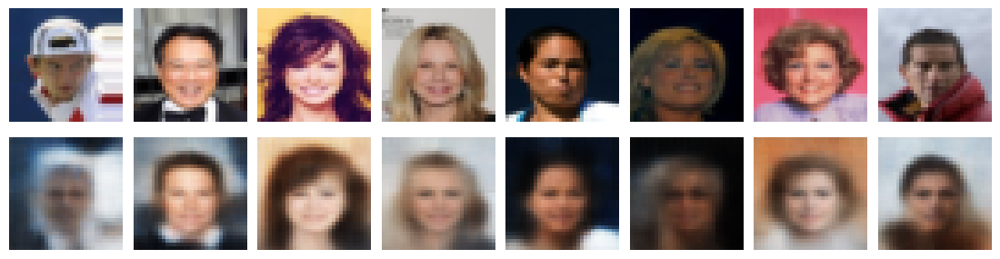

FID: 595.849
1500/1500 [==============================] - 59s 39ms/step - batch: 749.5000 - size: 64.0000 - loss: 151.4808 - r_loss: 0.0103 - kl_loss: 48.6925
Epoch 18/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 63.9833 - loss: 150.9750 - r_loss: 0.0102 - kl_loss: 48.9001

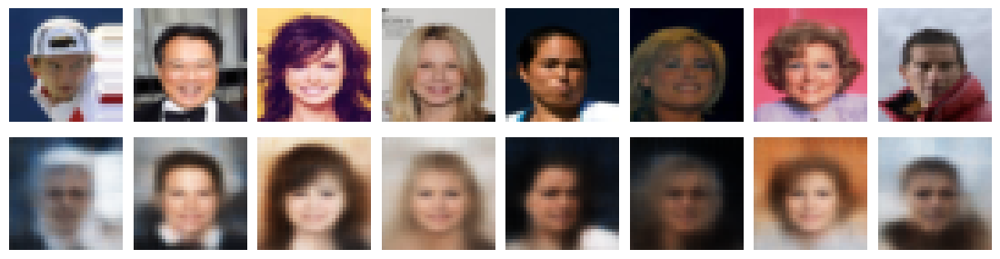

FID: 571.936
1500/1500 [==============================] - 57s 38ms/step - batch: 749.5000 - size: 63.9833 - loss: 150.9750 - r_loss: 0.0102 - kl_loss: 48.9001
Epoch 19/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 64.0000 - loss: 150.6215 - r_loss: 0.0102 - kl_loss: 49.0676

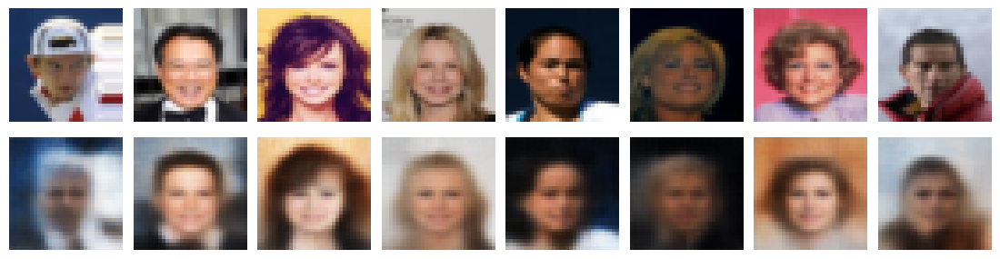

FID: 558.290
1500/1500 [==============================] - 58s 38ms/step - batch: 749.5000 - size: 64.0000 - loss: 150.6204 - r_loss: 0.0102 - kl_loss: 49.0675
Epoch 20/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 63.9833 - loss: 150.5215 - r_loss: 0.0101 - kl_loss: 49.2513

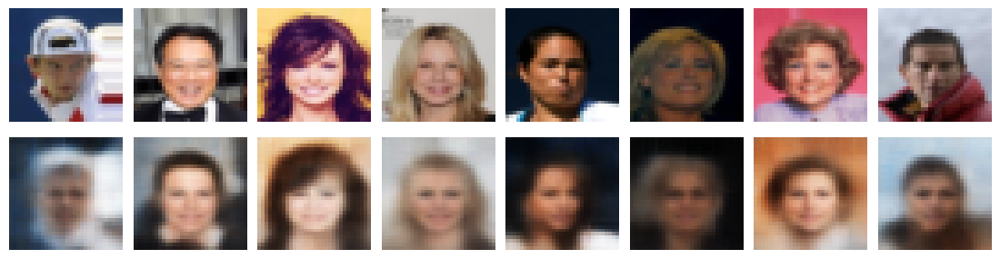

FID: 568.039
1500/1500 [==============================] - 61s 41ms/step - batch: 749.5000 - size: 63.9833 - loss: 150.5180 - r_loss: 0.0101 - kl_loss: 49.2515
Epoch 21/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 64.0000 - loss: 149.6092 - r_loss: 0.0100 - kl_loss: 49.2610

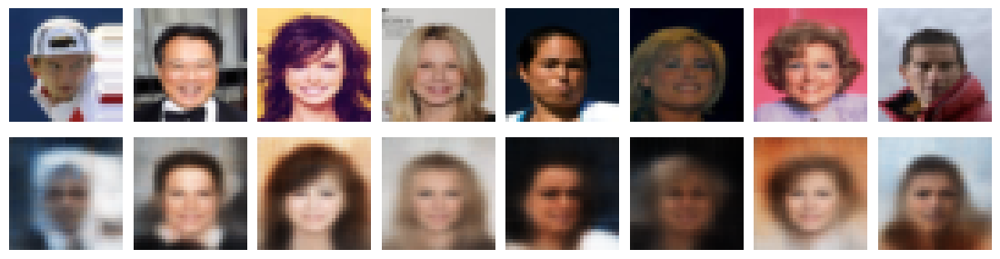

FID: 584.426
1500/1500 [==============================] - 56s 37ms/step - batch: 749.5000 - size: 64.0000 - loss: 149.6092 - r_loss: 0.0100 - kl_loss: 49.2610
Epoch 22/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 64.0000 - loss: 149.6439 - r_loss: 0.0100 - kl_loss: 49.4091

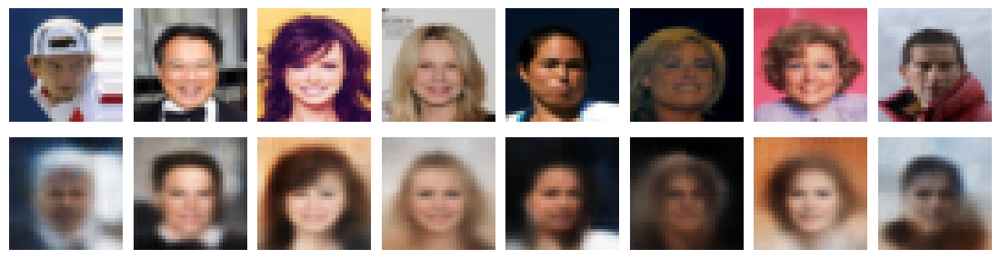

FID: 580.975
1500/1500 [==============================] - 57s 38ms/step - batch: 749.5000 - size: 64.0000 - loss: 149.6439 - r_loss: 0.0100 - kl_loss: 49.4091
Epoch 23/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 63.9833 - loss: 149.4004 - r_loss: 0.0100 - kl_loss: 49.5117

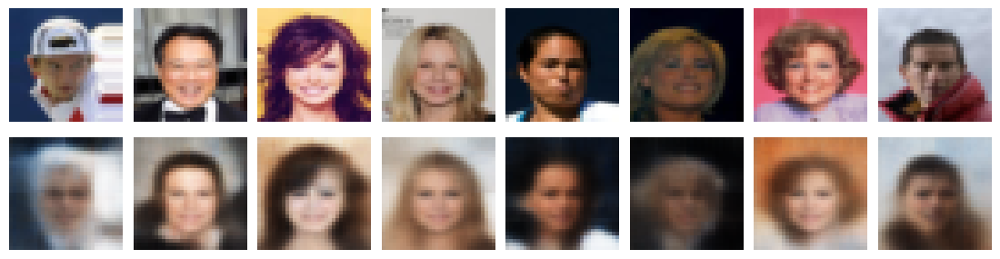

FID: 551.118
1500/1500 [==============================] - 61s 41ms/step - batch: 749.5000 - size: 63.9833 - loss: 149.4054 - r_loss: 0.0100 - kl_loss: 49.5119
Epoch 24/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 64.0000 - loss: 149.0447 - r_loss: 0.0099 - kl_loss: 49.5977

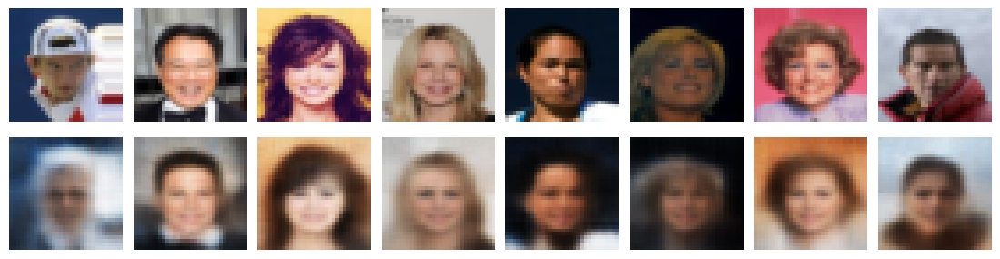

FID: 582.514
1500/1500 [==============================] - 57s 38ms/step - batch: 749.5000 - size: 64.0000 - loss: 149.0428 - r_loss: 0.0099 - kl_loss: 49.5975
Epoch 25/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 63.9833 - loss: 148.8793 - r_loss: 0.0099 - kl_loss: 49.6908

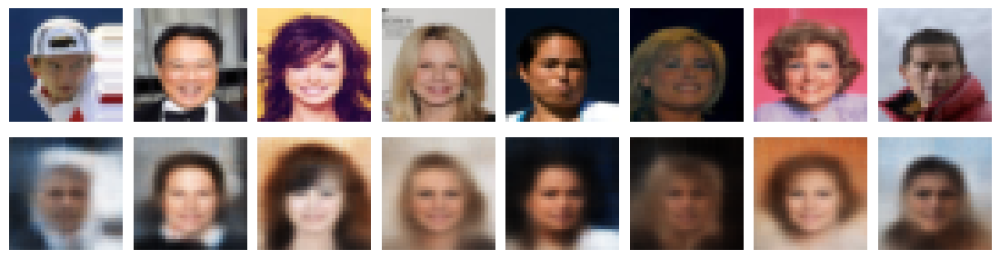

FID: 566.801
1500/1500 [==============================] - 55s 37ms/step - batch: 749.5000 - size: 63.9833 - loss: 148.8812 - r_loss: 0.0099 - kl_loss: 49.6916
Epoch 26/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 63.9833 - loss: 148.7153 - r_loss: 0.0099 - kl_loss: 49.8039

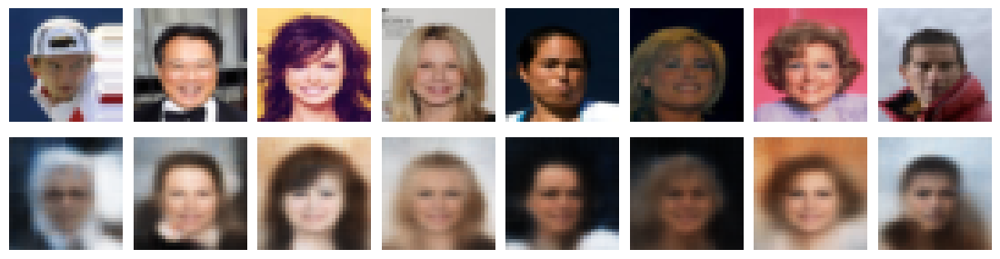

FID: 562.790
1500/1500 [==============================] - 61s 41ms/step - batch: 749.5000 - size: 63.9833 - loss: 148.7152 - r_loss: 0.0099 - kl_loss: 49.8049
Epoch 27/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 64.0000 - loss: 148.5185 - r_loss: 0.0099 - kl_loss: 49.8799

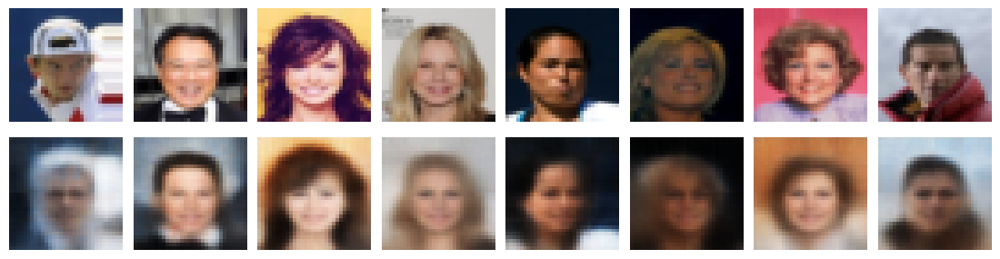

FID: 553.494
1500/1500 [==============================] - 56s 37ms/step - batch: 749.5000 - size: 64.0000 - loss: 148.5185 - r_loss: 0.0099 - kl_loss: 49.8799
Epoch 28/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 64.0000 - loss: 148.1085 - r_loss: 0.0098 - kl_loss: 49.9527

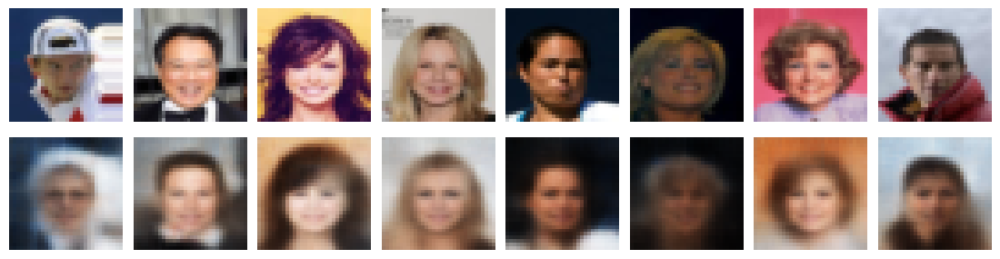

FID: 566.638
1500/1500 [==============================] - 57s 38ms/step - batch: 749.5000 - size: 64.0000 - loss: 148.1085 - r_loss: 0.0098 - kl_loss: 49.9527
Epoch 29/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 63.9833 - loss: 147.9226 - r_loss: 0.0098 - kl_loss: 50.0283

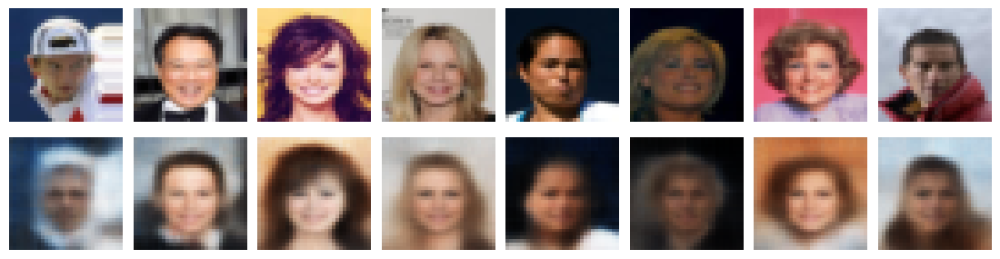

FID: 558.056
1500/1500 [==============================] - 62s 41ms/step - batch: 749.5000 - size: 63.9833 - loss: 147.9252 - r_loss: 0.0098 - kl_loss: 50.0287
Epoch 30/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 64.0000 - loss: 147.7025 - r_loss: 0.0098 - kl_loss: 50.1181

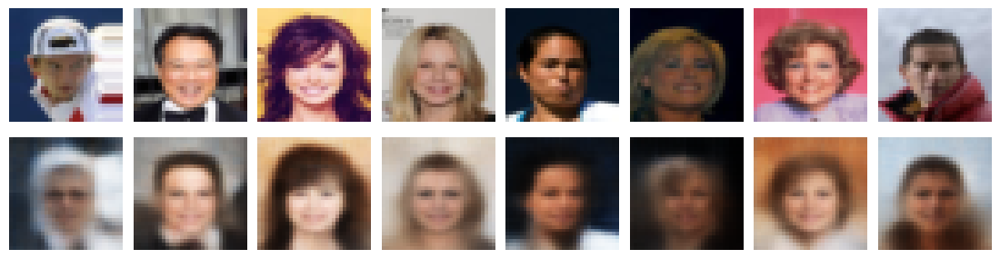

FID: 580.055
1500/1500 [==============================] - 57s 38ms/step - batch: 749.5000 - size: 64.0000 - loss: 147.7025 - r_loss: 0.0098 - kl_loss: 50.1181
Epoch 31/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 63.9833 - loss: 147.6863 - r_loss: 0.0097 - kl_loss: 50.1968

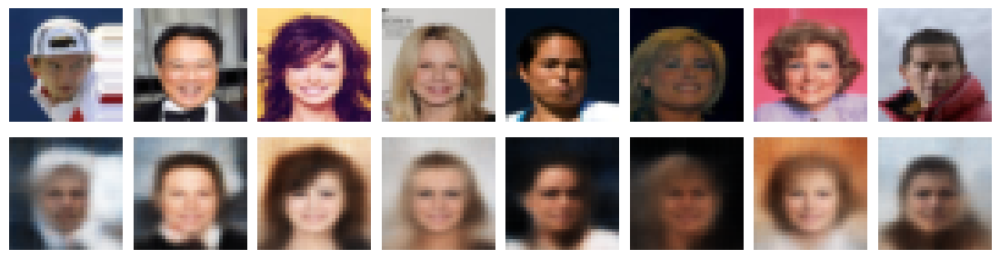

FID: 574.975
1500/1500 [==============================] - 56s 37ms/step - batch: 749.5000 - size: 63.9833 - loss: 147.6884 - r_loss: 0.0097 - kl_loss: 50.1973
Epoch 32/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 64.0000 - loss: 147.3605 - r_loss: 0.0097 - kl_loss: 50.2781

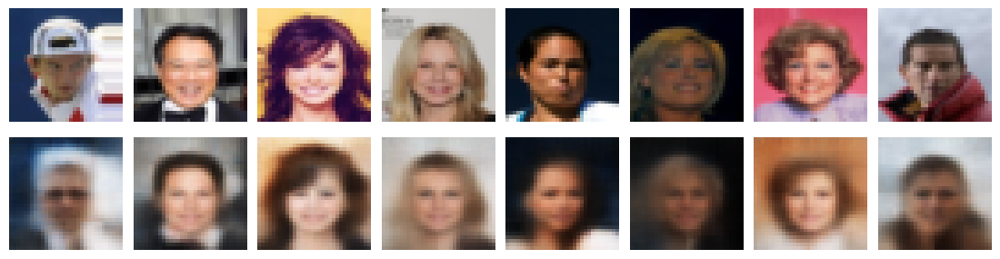

FID: 564.712
1500/1500 [==============================] - 64s 42ms/step - batch: 749.5000 - size: 64.0000 - loss: 147.3605 - r_loss: 0.0097 - kl_loss: 50.2781
Epoch 33/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 64.0000 - loss: 147.2636 - r_loss: 0.0097 - kl_loss: 50.2641

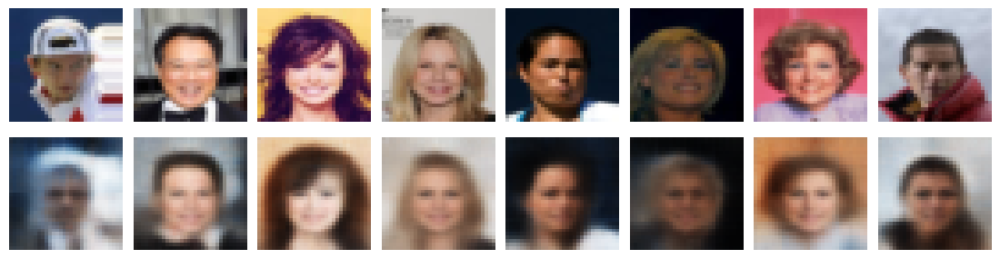

FID: 556.698
1500/1500 [==============================] - 58s 38ms/step - batch: 749.5000 - size: 64.0000 - loss: 147.2635 - r_loss: 0.0097 - kl_loss: 50.2639
Epoch 34/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 63.9833 - loss: 147.3423 - r_loss: 0.0097 - kl_loss: 50.3810

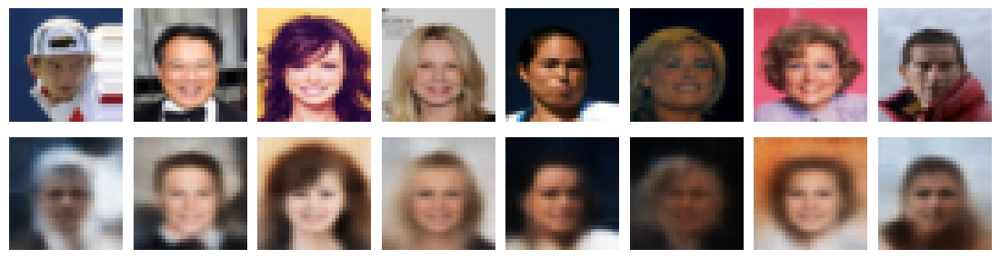

FID: 573.382
1500/1500 [==============================] - 58s 38ms/step - batch: 749.5000 - size: 63.9833 - loss: 147.3431 - r_loss: 0.0097 - kl_loss: 50.3819
Epoch 35/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 64.0000 - loss: 146.8636 - r_loss: 0.0096 - kl_loss: 50.3880

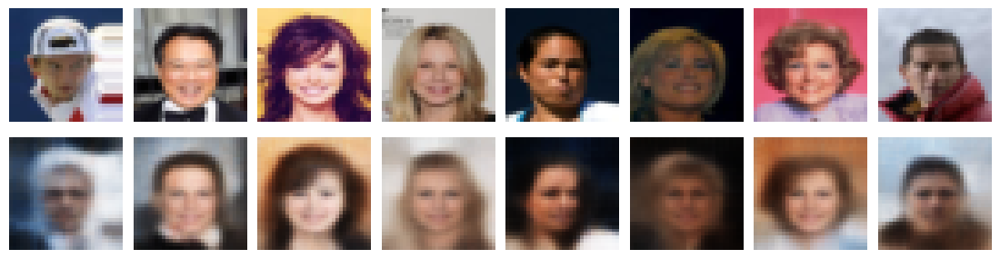

FID: 561.526
1500/1500 [==============================] - 60s 40ms/step - batch: 749.5000 - size: 64.0000 - loss: 146.8663 - r_loss: 0.0096 - kl_loss: 50.3883
Epoch 36/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 63.9833 - loss: 147.0516 - r_loss: 0.0097 - kl_loss: 50.4664

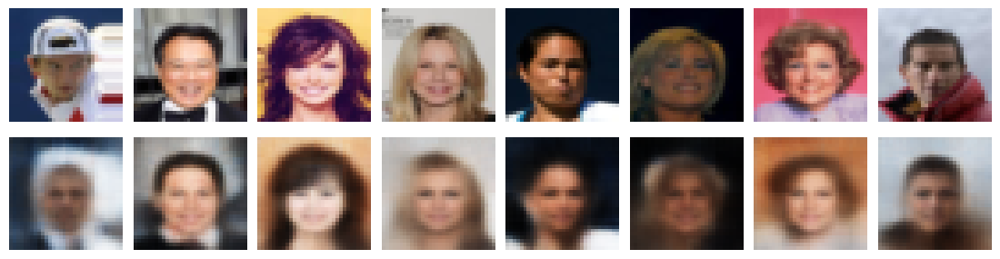

FID: 568.845
1500/1500 [==============================] - 58s 39ms/step - batch: 749.5000 - size: 63.9833 - loss: 147.0484 - r_loss: 0.0097 - kl_loss: 50.4653
Epoch 37/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 63.9833 - loss: 146.7103 - r_loss: 0.0096 - kl_loss: 50.4891

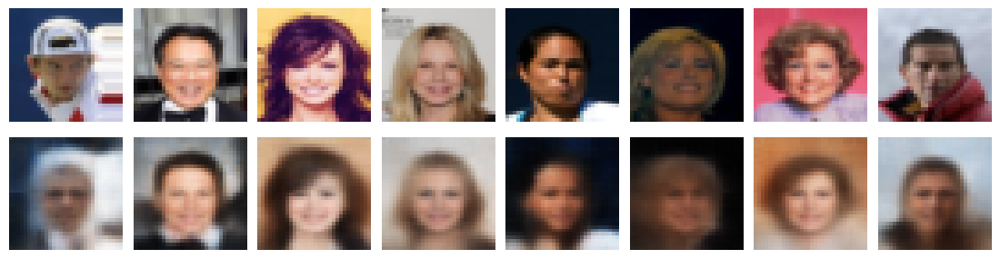

FID: 571.888
1500/1500 [==============================] - 56s 37ms/step - batch: 749.5000 - size: 63.9833 - loss: 146.7167 - r_loss: 0.0096 - kl_loss: 50.4903
Epoch 38/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 64.0000 - loss: 146.8677 - r_loss: 0.0096 - kl_loss: 50.6024

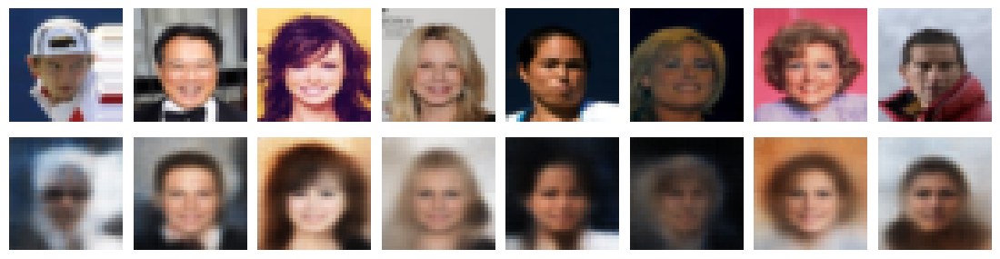

FID: 570.546
1500/1500 [==============================] - 63s 42ms/step - batch: 749.5000 - size: 64.0000 - loss: 146.8706 - r_loss: 0.0096 - kl_loss: 50.6035
Epoch 39/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 64.0000 - loss: 146.5167 - r_loss: 0.0096 - kl_loss: 50.5699

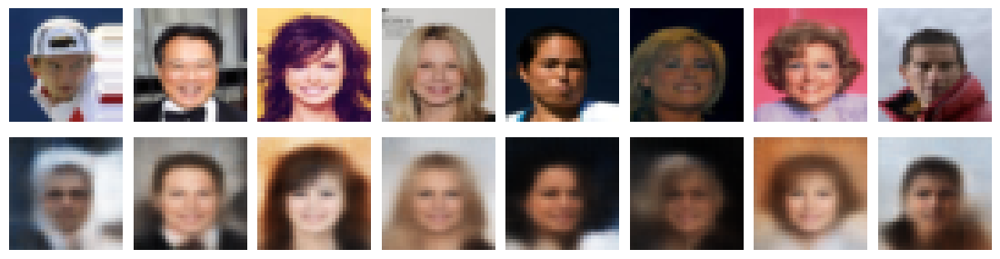

FID: 555.289
1500/1500 [==============================] - 56s 37ms/step - batch: 749.5000 - size: 64.0000 - loss: 146.5167 - r_loss: 0.0096 - kl_loss: 50.5699
Epoch 40/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 63.9833 - loss: 146.5518 - r_loss: 0.0096 - kl_loss: 50.6045

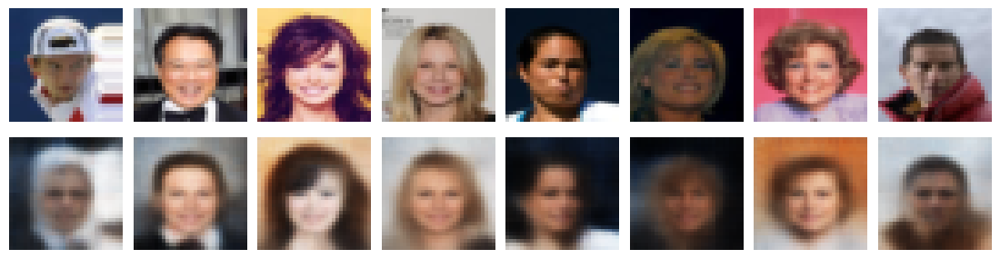

FID: 572.999
1500/1500 [==============================] - 58s 39ms/step - batch: 749.5000 - size: 63.9833 - loss: 146.5619 - r_loss: 0.0096 - kl_loss: 50.6048
Epoch 41/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 63.9833 - loss: 146.3948 - r_loss: 0.0096 - kl_loss: 50.6496

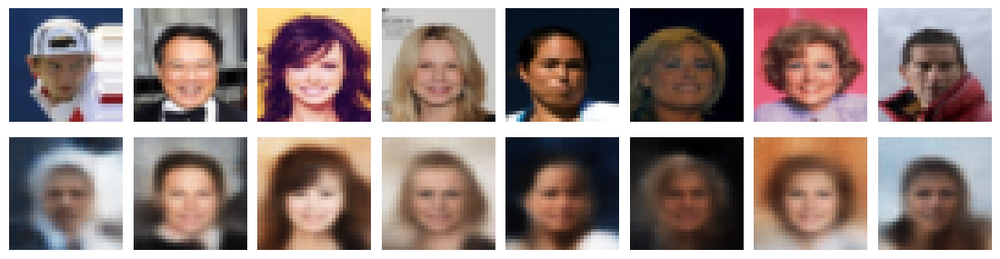

FID: 538.603
1500/1500 [==============================] - 58s 39ms/step - batch: 749.5000 - size: 63.9833 - loss: 146.3930 - r_loss: 0.0096 - kl_loss: 50.6496
Epoch 42/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 64.0000 - loss: 146.3470 - r_loss: 0.0096 - kl_loss: 50.7173

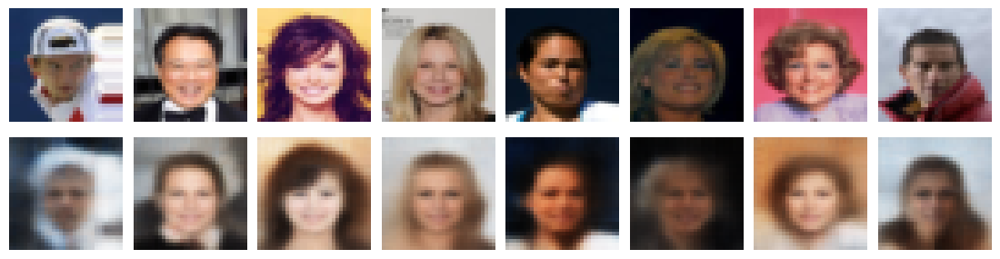

FID: 563.324
1500/1500 [==============================] - 59s 39ms/step - batch: 749.5000 - size: 64.0000 - loss: 146.3479 - r_loss: 0.0096 - kl_loss: 50.7175
Epoch 43/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 64.0000 - loss: 146.0910 - r_loss: 0.0095 - kl_loss: 50.7080

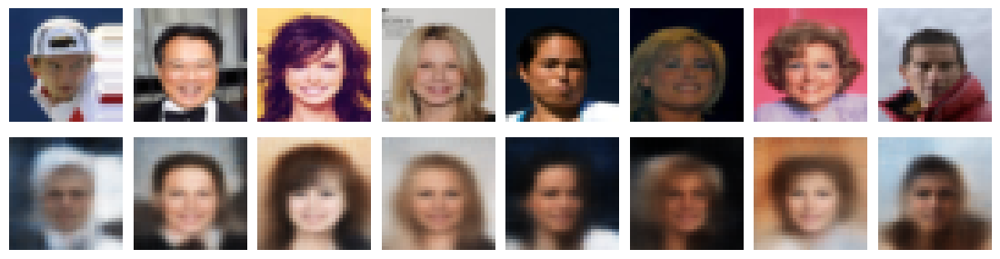

FID: 556.189
1500/1500 [==============================] - 59s 39ms/step - batch: 749.5000 - size: 64.0000 - loss: 146.0910 - r_loss: 0.0095 - kl_loss: 50.7080
Epoch 44/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 63.9833 - loss: 146.0714 - r_loss: 0.0095 - kl_loss: 50.7591

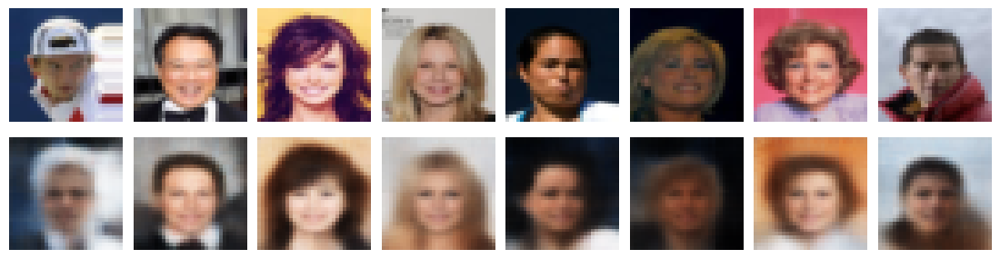

FID: 566.572
1500/1500 [==============================] - 58s 39ms/step - batch: 749.5000 - size: 63.9833 - loss: 146.0735 - r_loss: 0.0095 - kl_loss: 50.7592
Epoch 45/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 64.0000 - loss: 145.8542 - r_loss: 0.0095 - kl_loss: 50.7041

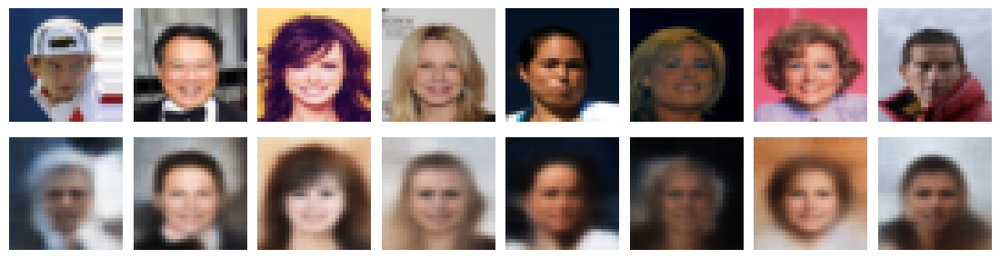

FID: 558.055
1500/1500 [==============================] - 58s 39ms/step - batch: 749.5000 - size: 64.0000 - loss: 145.8544 - r_loss: 0.0095 - kl_loss: 50.7044
Epoch 46/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 64.0000 - loss: 145.8762 - r_loss: 0.0095 - kl_loss: 50.8461

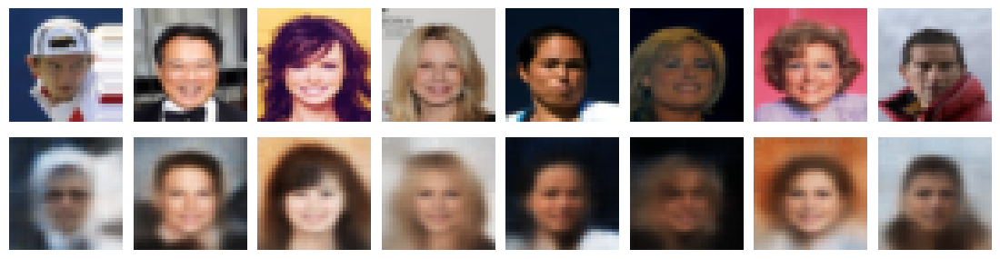

FID: 574.982
1500/1500 [==============================] - 62s 41ms/step - batch: 749.5000 - size: 64.0000 - loss: 145.8762 - r_loss: 0.0095 - kl_loss: 50.8461
Epoch 47/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 63.9833 - loss: 145.9544 - r_loss: 0.0095 - kl_loss: 50.8871

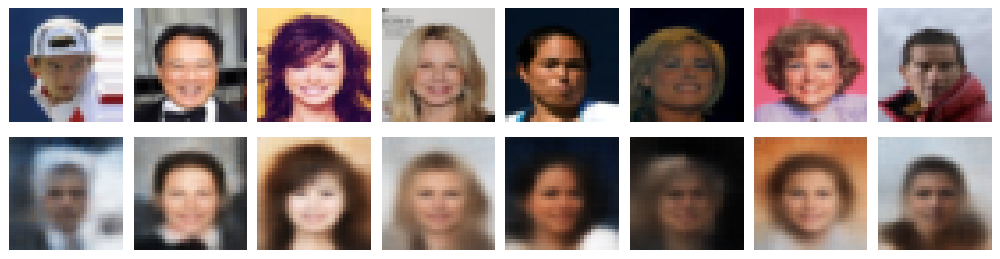

FID: 573.691
1500/1500 [==============================] - 57s 38ms/step - batch: 749.5000 - size: 63.9833 - loss: 145.9544 - r_loss: 0.0095 - kl_loss: 50.8871
Epoch 48/50
1498/1500 [============================>.] - ETA: 0s - batch: 748.5000 - size: 63.9833 - loss: 145.6676 - r_loss: 0.0095 - kl_loss: 50.8213

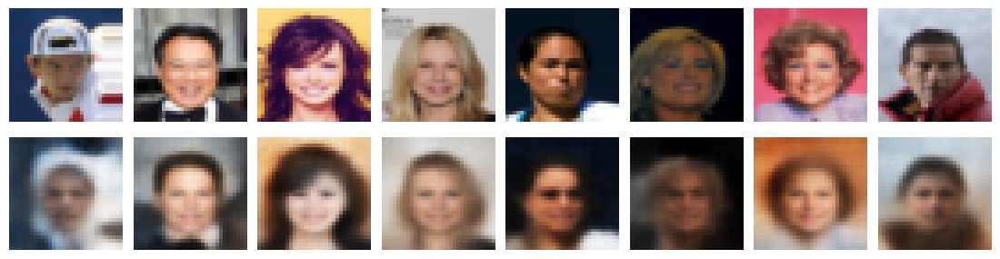

FID: 552.264
1500/1500 [==============================] - 57s 38ms/step - batch: 749.5000 - size: 63.9833 - loss: 145.6617 - r_loss: 0.0095 - kl_loss: 50.8223
Epoch 49/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 64.0000 - loss: 145.6944 - r_loss: 0.0095 - kl_loss: 50.9206

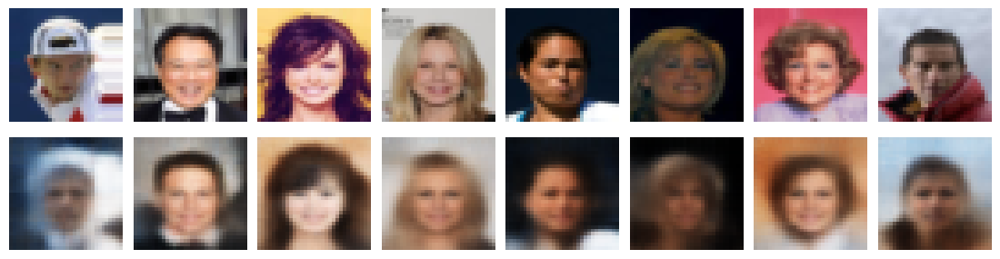

FID: 538.547
1500/1500 [==============================] - 62s 42ms/step - batch: 749.5000 - size: 64.0000 - loss: 145.6944 - r_loss: 0.0095 - kl_loss: 50.9206
Epoch 50/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 63.9833 - loss: 145.7369 - r_loss: 0.0095 - kl_loss: 50.9300

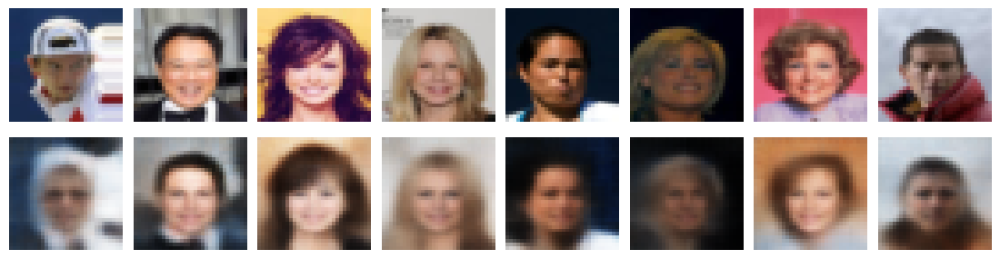

FID: 565.238
1500/1500 [==============================] - 58s 39ms/step - batch: 749.5000 - size: 63.9833 - loss: 145.7369 - r_loss: 0.0095 - kl_loss: 50.9300


In [ ]:
###################
# Training Params
###################

LEARNING_RATE = 0.0005
N_EPOCHS = 50
STEPS_PER_EPOCH = 1500 #NUM_IMAGES / BATCH_SIZE
adam_optimizer = Adam(learning_rate=LEARNING_RATE)

############
# Callbacks
############

batch = next(data_flow)
fid_calculator = FIDCalculator(vae_decoder, batch[0], Z_DIM)
image_generator_callback = ImageGenerator(data_samples_examples, vae_encoder, vae_decoder)

#########
# Train 
#########

vae.compile(optimizer=adam_optimizer, loss=total_loss, metrics=[r_loss, kl_loss])
history = vae.fit(data_flow, shuffle=True, epochs=N_EPOCHS, initial_epoch=0, steps_per_epoch=STEPS_PER_EPOCH, callbacks=[image_generator_callback, model_checkpoint_callback, fid_calculator])    
history = history.history

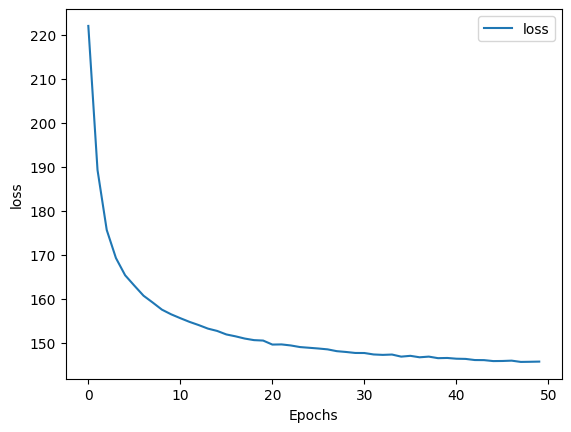

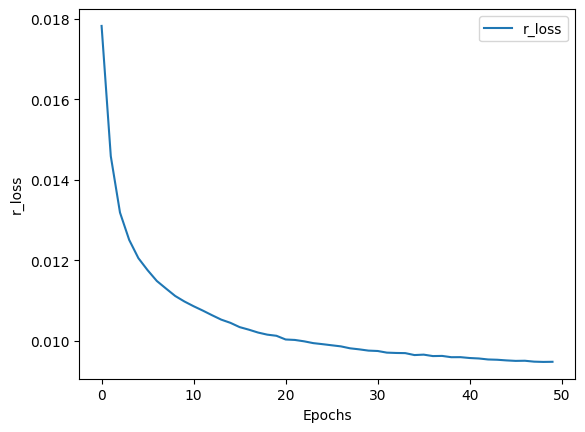

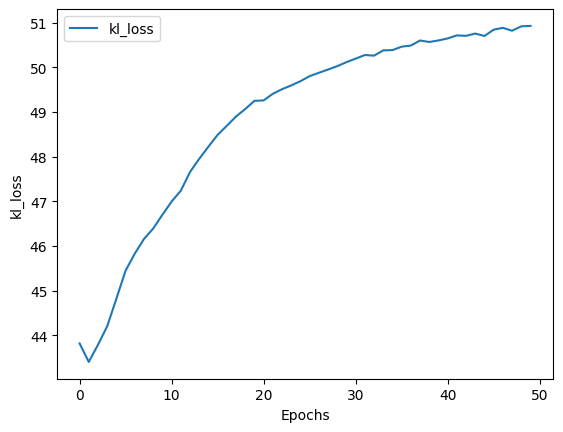

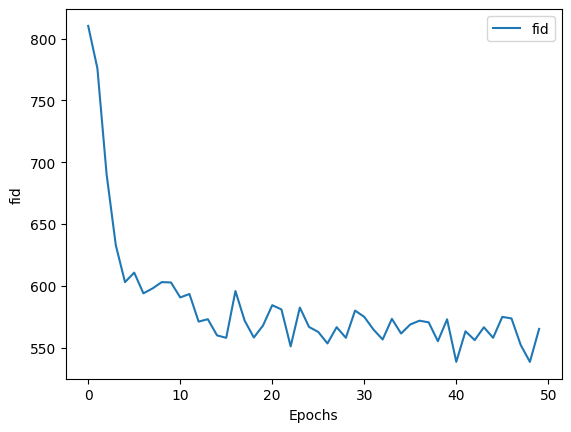

In [ ]:
history["fid"] = fid_calculator.log
plot_metrics(history)

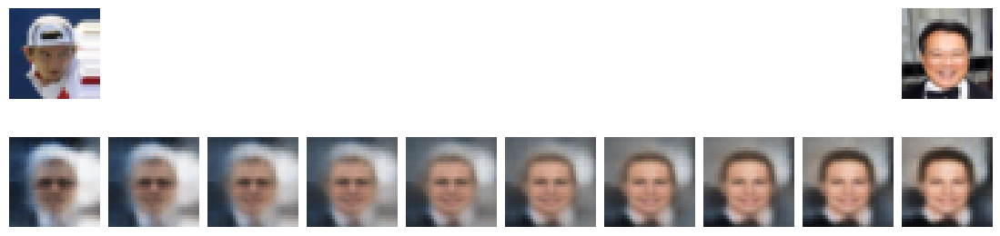

In [ ]:
linear_interpolation(data_samples_examples[0],data_samples_examples[1], vae_encoder, vae_decoder)

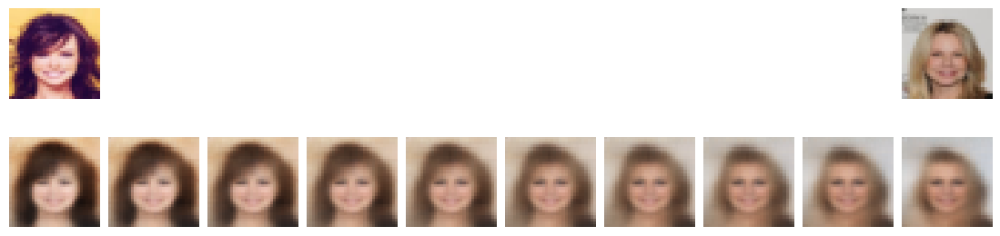

In [ ]:
linear_interpolation(data_samples_examples[2],data_samples_examples[3], vae_encoder, vae_decoder)

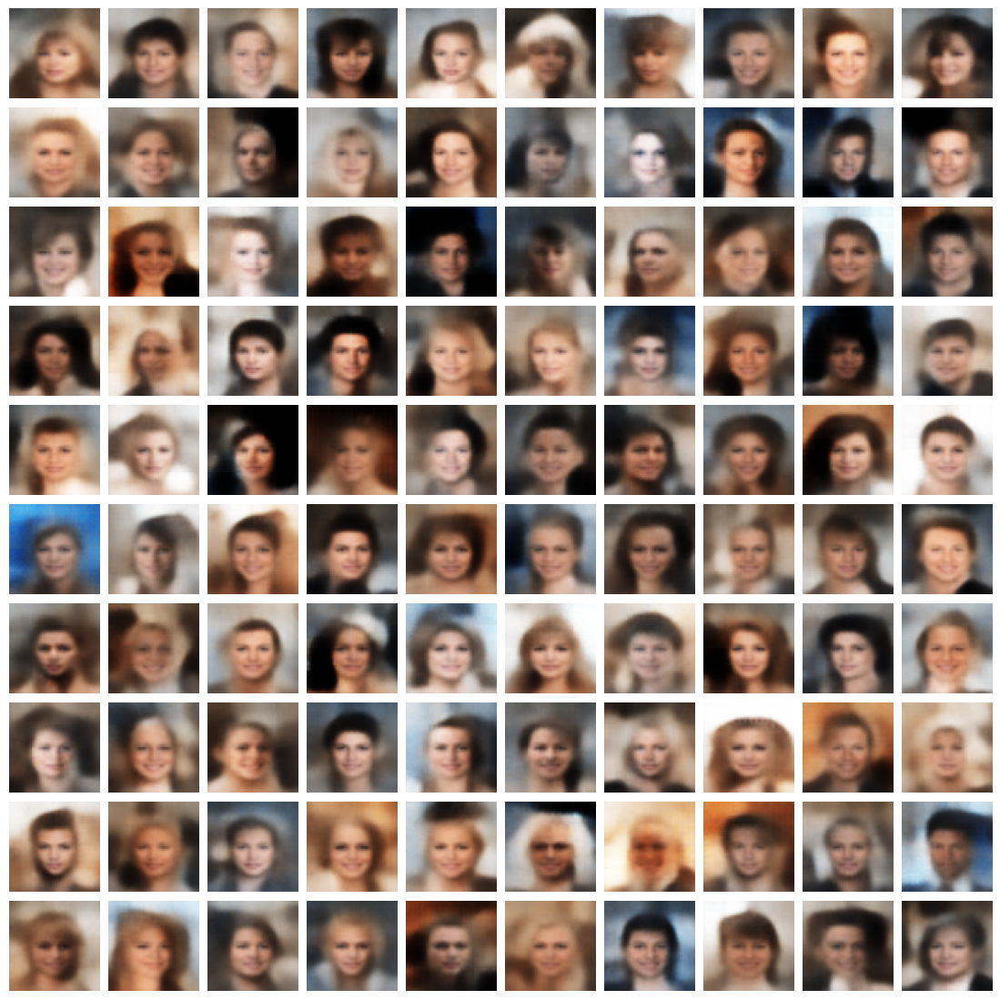

In [ ]:
plot_generated(vae_decoder, Z_DIM)

### Run 2

In the previous run, good convergence and metric values were observed. However, the qualities of the images generated from real images are not very fidelity with them. This, mixed with the low resolution of the images, makes it necessary to increase the size and completeness of the network.

For this, first of all, the resolution of the images will be increased, since visually the 32x32 images look quite low quality. Additionally, due to the fact that the correspondences between input and generated images were not the most adequate, the size of the latent space will be increased. 

Along with these modifications will be accompanied by a more complex convolutional architecture, looking for a more optimal feature extraction.

Furthermore, in order to avoid overfitting and vanishing gradients, dropout and batch normalization will be added to the encoder and decoder in the convolutional architecture, respectively. Also, residual connections will be added to favor the gradient flow over the network.

Finally, the learning rate has been slightly decreased, maintaining the number of epochs and amount of computation in them.

Found 202599 images belonging to 1 classes.


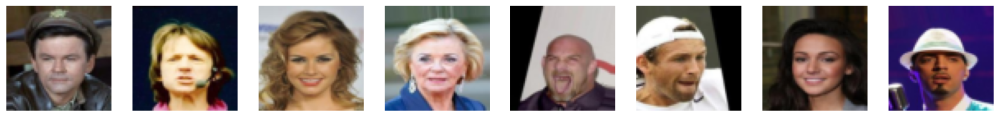

In [ ]:
# Constants
IMAGE_SIZE = 64
CHANNELS = 3
Z_DIM = 256  

# Generator that creates batches of rgb images in the range [0,1]
data_flow = ImageDataGenerator(rescale=1./255).flow_from_directory(
    DATA_FOLDER, 
    target_size=(IMAGE_SIZE,IMAGE_SIZE),
    batch_size=BATCH_SIZE,
    shuffle=True,
    class_mode='input', 
    color_mode='rgb',
    interpolation='bilinear'
)
data_samples_examples = next(data_flow)[0][:8]
display(data_samples_examples, cmap='viridis')

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 encoder_input (InputLayer)     [(None, 64, 64, 3)]  0           []                               
                                                                                                  
 encoder_conv_0 (Conv2D)        (None, 64, 64, 16)   448         ['encoder_input[0][0]']          
                                                                                                  
 leaky_re_lu (LeakyReLU)        (None, 64, 64, 16)   0           ['encoder_conv_0[0][0]']         
                                                                                                  
 encoder_conv_1 (Conv2D)        (None, 32, 32, 16)   2320        ['leaky_re_lu[0][0]']            
                                                                                              

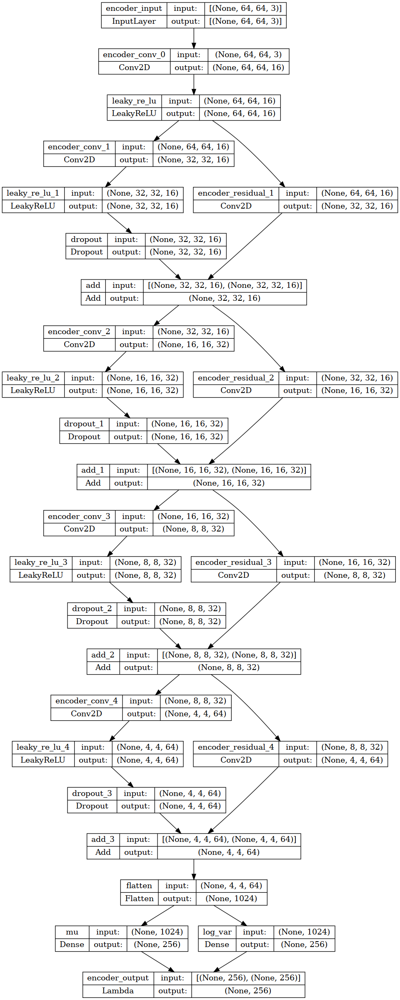

In [ ]:
################
# Encoder Init
################

vae_encoder_input, vae_encoder_output, mean_mu, log_var, vae_shape_before_flattening, vae_encoder = build_vae_encoder(
    input_dim=(IMAGE_SIZE,IMAGE_SIZE,CHANNELS),
    output_dim=Z_DIM, 
    conv_filters=[16, 16, 32, 32, 64],
    conv_kernel_size=[3, 3, 3, 3, 3],
    conv_strides=[1, 2, 2, 2, 2],
    use_dropout=True,
    use_residual=True,
)
vae_encoder.summary()
plot_model(vae_encoder, show_shapes=True, show_layer_names=True)

Model: "model_6"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 decoder_input (InputLayer)     [(None, 256)]        0           []                               
                                                                                                  
 dense_3 (Dense)                (None, 1024)         263168      ['decoder_input[0][0]']          
                                                                                                  
 reshape_3 (Reshape)            (None, 4, 4, 64)     0           ['dense_3[0][0]']                
                                                                                                  
 decoder_conv_0 (Conv2DTranspos  (None, 4, 4, 64)    36928       ['reshape_3[0][0]']              
 e)                                                                                         

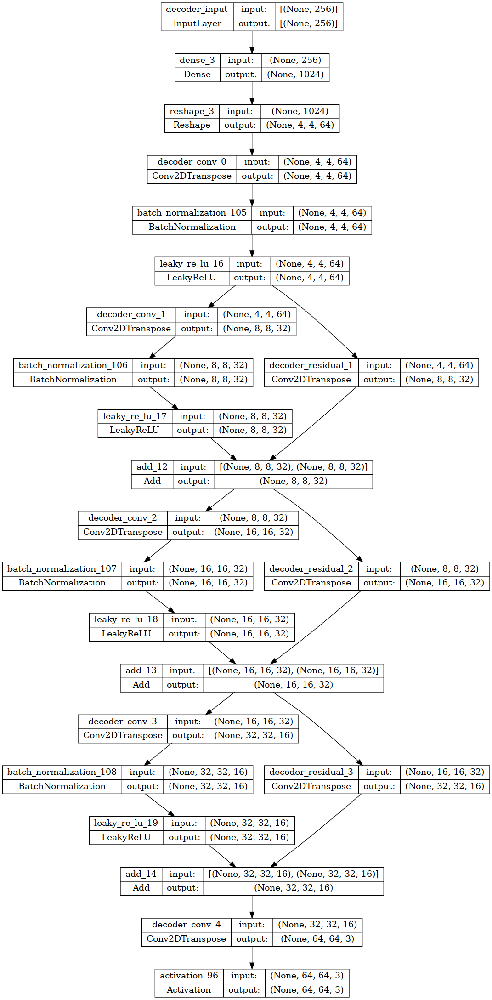

In [ ]:
################
# Decoder Init
################

decoder_input, decoder_output, vae_decoder = build_decoder(
    input_dim=Z_DIM,
    shape_before_flattening=vae_shape_before_flattening,
    conv_filters = [64, 32, 32, 16, CHANNELS],
    conv_kernel_size = [3, 3, 3, 3, 3],
    conv_strides = [1, 2, 2, 2, 2],
    use_bn=True,
    use_residual=True
)
vae_decoder.summary()
plot_model(vae_decoder, show_shapes=True, show_layer_names=True)

In [ ]:
##########################
# Variational AutoEncoder
##########################

vae = Model(vae_encoder_input, vae_decoder(vae_encoder_output))
vae.summary()

Model: "model_7"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 encoder_input (InputLayer)     [(None, 64, 64, 3)]  0           []                               
                                                                                                  
 encoder_conv_0 (Conv2D)        (None, 64, 64, 16)   448         ['encoder_input[0][0]']          
                                                                                                  
 leaky_re_lu (LeakyReLU)        (None, 64, 64, 16)   0           ['encoder_conv_0[0][0]']         
                                                                                                  
 encoder_conv_1 (Conv2D)        (None, 32, 32, 16)   2320        ['leaky_re_lu[0][0]']            
                                                                                            

Epoch 1/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 64.0000 - loss: 362.2757 - r_loss: 0.0315 - kl_loss: 47.2859

/home/pedro/.local/lib/python3.9/site-packages/keras/engine/training_v1.py:2359: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates=self.state_updates,


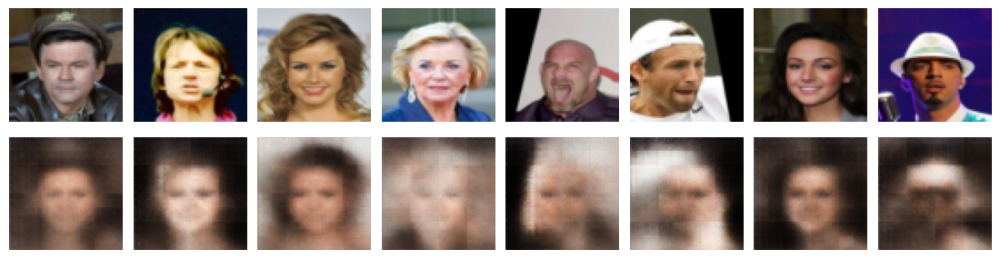

FID: 1434.097
1500/1500 [==============================] - 84s 54ms/step - batch: 749.5000 - size: 64.0000 - loss: 362.2757 - r_loss: 0.0315 - kl_loss: 47.2859
Epoch 2/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 63.9833 - loss: 232.9809 - r_loss: 0.0183 - kl_loss: 49.5588

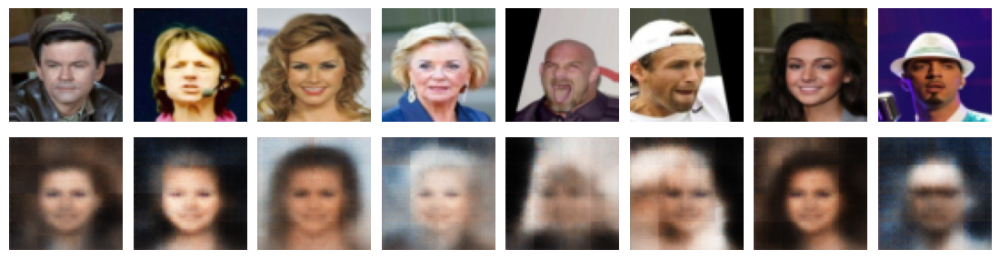

FID: 1222.145
1500/1500 [==============================] - 75s 50ms/step - batch: 749.5000 - size: 63.9833 - loss: 232.9809 - r_loss: 0.0183 - kl_loss: 49.5588
Epoch 3/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 64.0000 - loss: 209.2101 - r_loss: 0.0160 - kl_loss: 49.5297

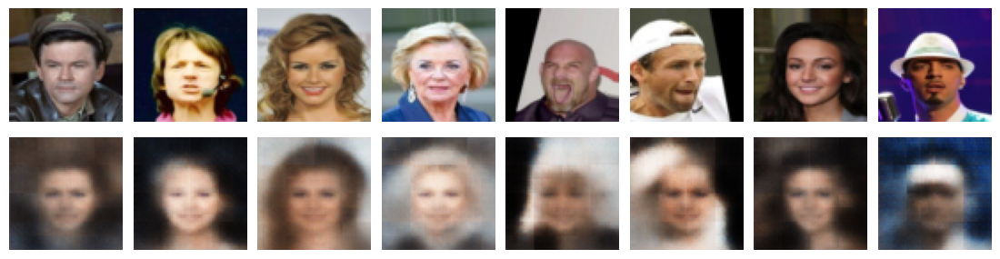

FID: 1169.898
1500/1500 [==============================] - 64s 43ms/step - batch: 749.5000 - size: 64.0000 - loss: 209.2101 - r_loss: 0.0160 - kl_loss: 49.5297
Epoch 4/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 64.0000 - loss: 200.2032 - r_loss: 0.0150 - kl_loss: 49.8675

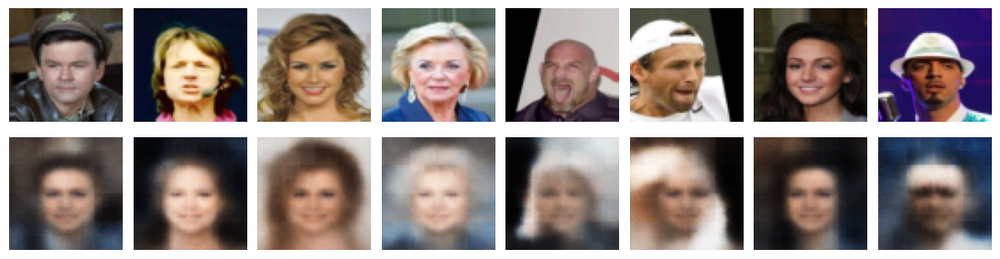

FID: 1100.177
1500/1500 [==============================] - 63s 42ms/step - batch: 749.5000 - size: 64.0000 - loss: 200.2032 - r_loss: 0.0150 - kl_loss: 49.8675
Epoch 5/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 63.9833 - loss: 195.8624 - r_loss: 0.0145 - kl_loss: 50.6053

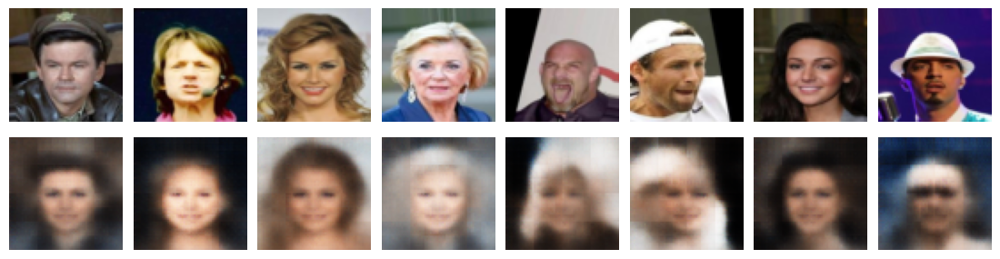

FID: 1102.399
1500/1500 [==============================] - 61s 41ms/step - batch: 749.5000 - size: 63.9833 - loss: 195.8583 - r_loss: 0.0145 - kl_loss: 50.6071
Epoch 6/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 63.9833 - loss: 192.4187 - r_loss: 0.0141 - kl_loss: 51.3189

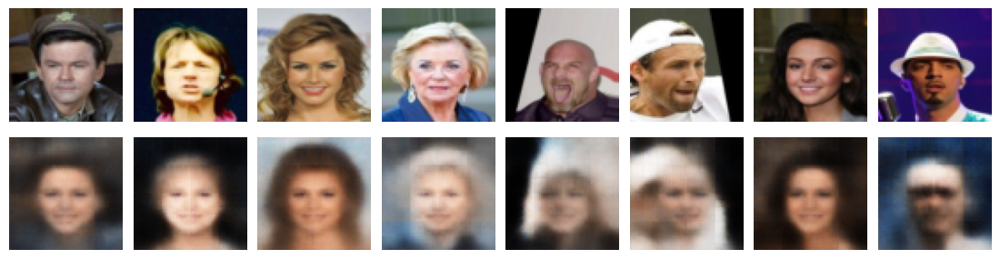

FID: 1072.695
1500/1500 [==============================] - 63s 42ms/step - batch: 749.5000 - size: 63.9833 - loss: 192.4143 - r_loss: 0.0141 - kl_loss: 51.3179
Epoch 7/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 64.0000 - loss: 190.4578 - r_loss: 0.0139 - kl_loss: 51.9248

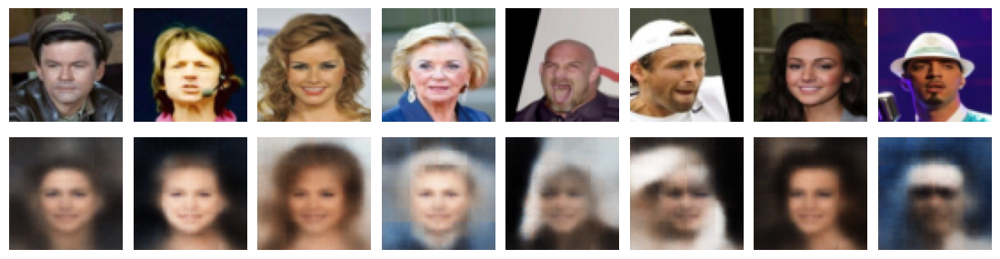

FID: 1065.028
1500/1500 [==============================] - 61s 41ms/step - batch: 749.5000 - size: 64.0000 - loss: 190.4643 - r_loss: 0.0139 - kl_loss: 51.9253
Epoch 8/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 63.9833 - loss: 188.2900 - r_loss: 0.0136 - kl_loss: 52.3453

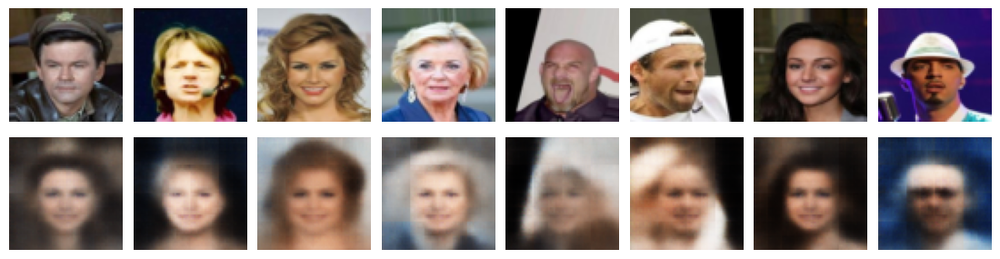

FID: 1044.216
1500/1500 [==============================] - 61s 41ms/step - batch: 749.5000 - size: 63.9833 - loss: 188.2921 - r_loss: 0.0136 - kl_loss: 52.3463
Epoch 9/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 64.0000 - loss: 186.6245 - r_loss: 0.0134 - kl_loss: 52.7111

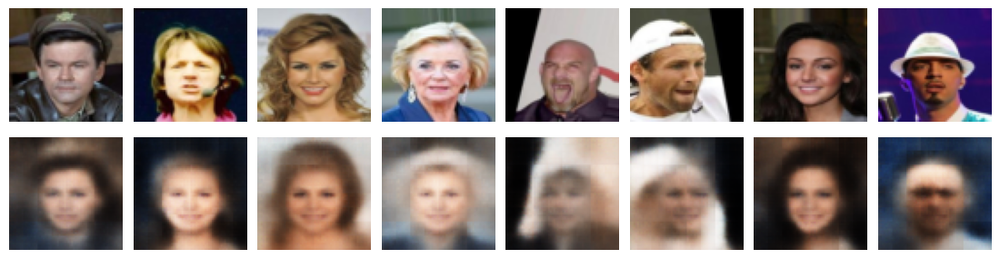

FID: 1035.600
1500/1500 [==============================] - 62s 42ms/step - batch: 749.5000 - size: 64.0000 - loss: 186.6245 - r_loss: 0.0134 - kl_loss: 52.7111
Epoch 10/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 64.0000 - loss: 185.6183 - r_loss: 0.0133 - kl_loss: 52.9793

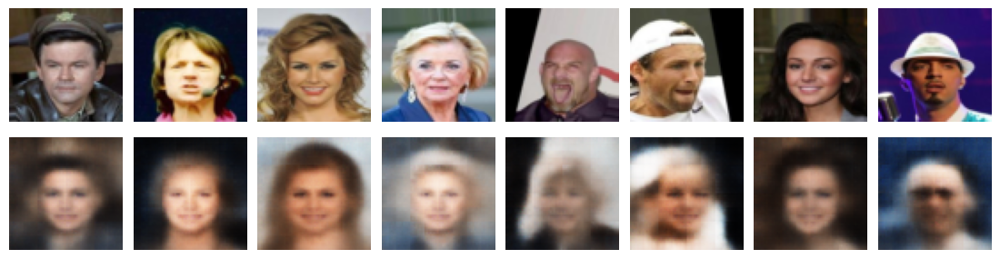

FID: 1062.583
1500/1500 [==============================] - 63s 42ms/step - batch: 749.5000 - size: 64.0000 - loss: 185.6165 - r_loss: 0.0133 - kl_loss: 52.9792
Epoch 11/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 63.9666 - loss: 184.6026 - r_loss: 0.0131 - kl_loss: 53.3202

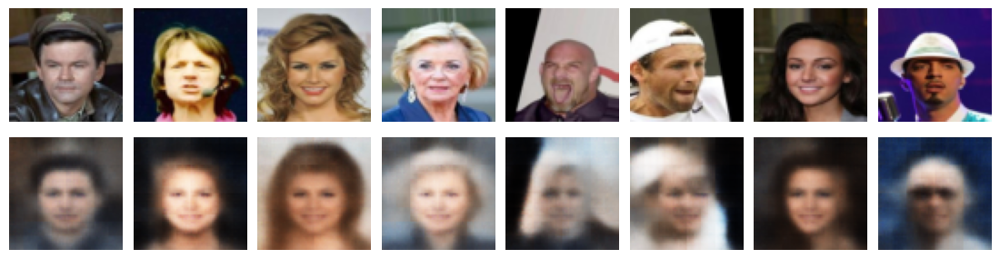

FID: 1055.531
1500/1500 [==============================] - 63s 42ms/step - batch: 749.5000 - size: 63.9667 - loss: 184.6002 - r_loss: 0.0131 - kl_loss: 53.3206
Epoch 12/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 64.0000 - loss: 183.4879 - r_loss: 0.0130 - kl_loss: 53.4876

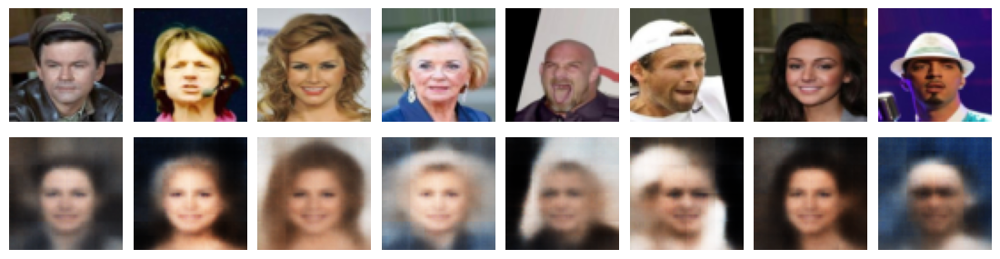

FID: 1054.809
1500/1500 [==============================] - 63s 42ms/step - batch: 749.5000 - size: 64.0000 - loss: 183.4879 - r_loss: 0.0130 - kl_loss: 53.4876
Epoch 13/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 63.9833 - loss: 183.1033 - r_loss: 0.0129 - kl_loss: 53.7791

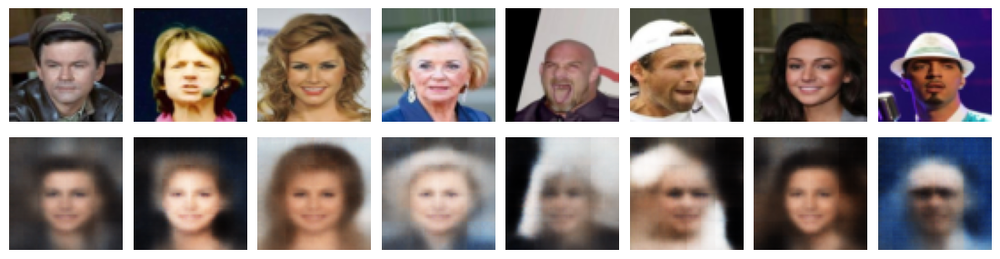

FID: 991.775
1500/1500 [==============================] - 61s 41ms/step - batch: 749.5000 - size: 63.9833 - loss: 183.0959 - r_loss: 0.0129 - kl_loss: 53.7776
Epoch 14/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 64.0000 - loss: 182.5060 - r_loss: 0.0128 - kl_loss: 54.0709

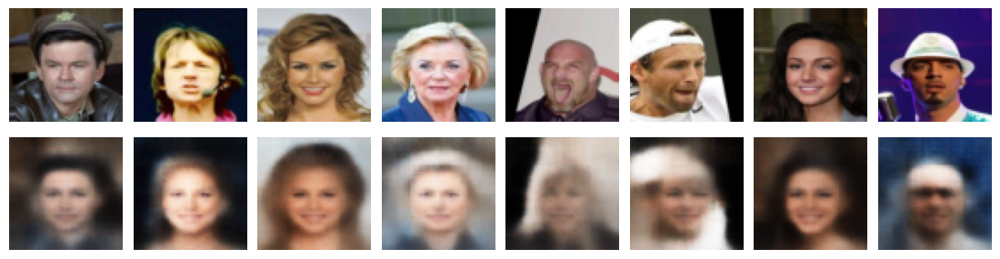

FID: 1010.343
1500/1500 [==============================] - 61s 41ms/step - batch: 749.5000 - size: 64.0000 - loss: 182.4992 - r_loss: 0.0128 - kl_loss: 54.0706
Epoch 15/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 64.0000 - loss: 181.5158 - r_loss: 0.0127 - kl_loss: 54.1831

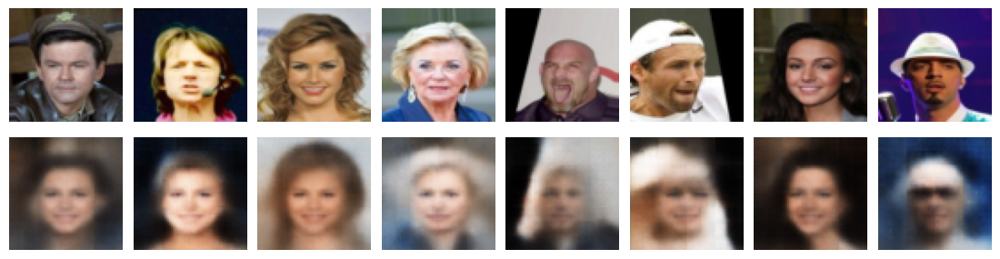

FID: 1036.275
1500/1500 [==============================] - 63s 42ms/step - batch: 749.5000 - size: 64.0000 - loss: 181.5307 - r_loss: 0.0127 - kl_loss: 54.1851
Epoch 16/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 63.9833 - loss: 180.9497 - r_loss: 0.0127 - kl_loss: 54.3534

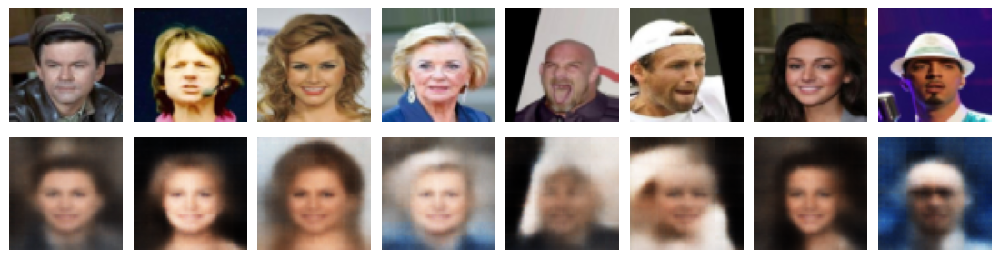

FID: 1052.255
1500/1500 [==============================] - 63s 42ms/step - batch: 749.5000 - size: 63.9833 - loss: 180.9497 - r_loss: 0.0127 - kl_loss: 54.3534
Epoch 17/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 64.0000 - loss: 180.6789 - r_loss: 0.0126 - kl_loss: 54.5495

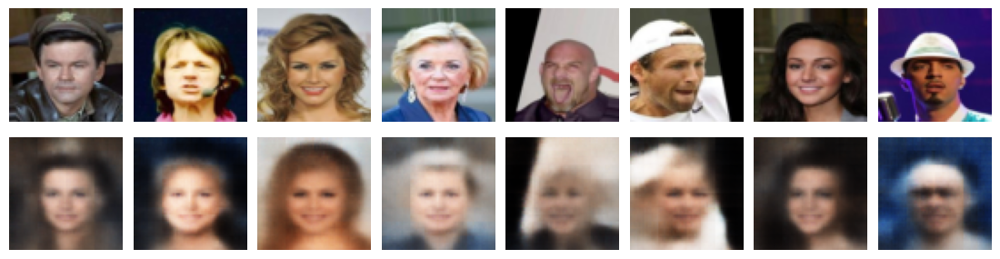

FID: 1037.521
1500/1500 [==============================] - 63s 42ms/step - batch: 749.5000 - size: 64.0000 - loss: 180.6748 - r_loss: 0.0126 - kl_loss: 54.5480
Epoch 18/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 63.9833 - loss: 180.1087 - r_loss: 0.0126 - kl_loss: 54.5706

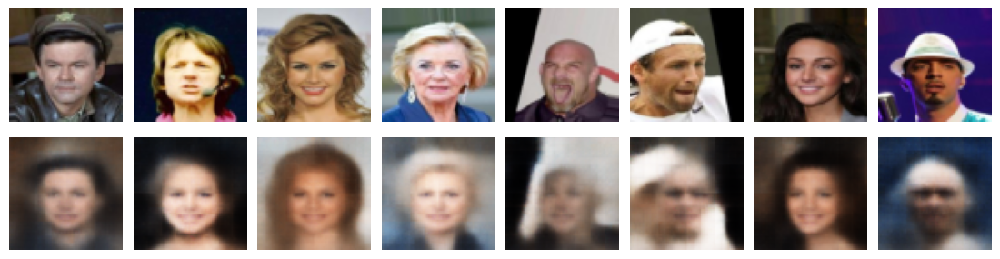

FID: 1016.244
1500/1500 [==============================] - 61s 41ms/step - batch: 749.5000 - size: 63.9833 - loss: 180.1087 - r_loss: 0.0126 - kl_loss: 54.5706
Epoch 19/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 64.0000 - loss: 179.6788 - r_loss: 0.0125 - kl_loss: 54.6792

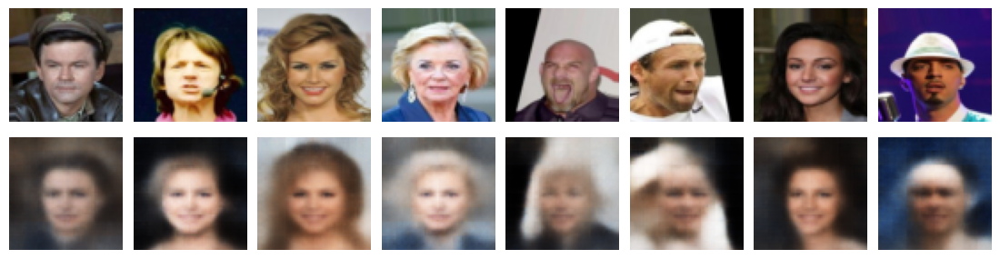

FID: 1025.860
1500/1500 [==============================] - 63s 42ms/step - batch: 749.5000 - size: 64.0000 - loss: 179.6768 - r_loss: 0.0125 - kl_loss: 54.6790
Epoch 20/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 64.0000 - loss: 179.4836 - r_loss: 0.0125 - kl_loss: 54.8092

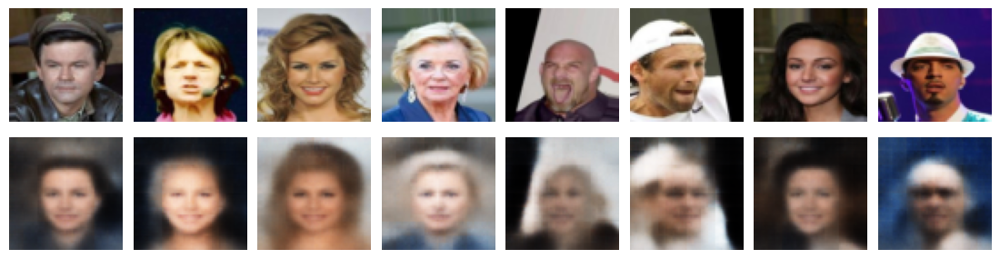

FID: 1021.817
1500/1500 [==============================] - 61s 41ms/step - batch: 749.5000 - size: 64.0000 - loss: 179.4836 - r_loss: 0.0125 - kl_loss: 54.8092
Epoch 21/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 63.9833 - loss: 178.9562 - r_loss: 0.0124 - kl_loss: 54.7710

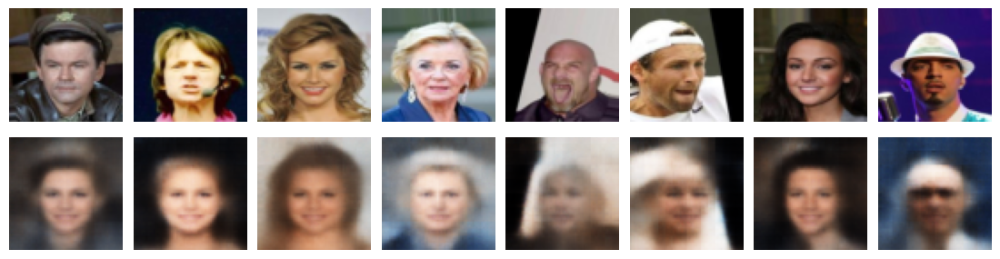

FID: 1011.000
1500/1500 [==============================] - 61s 41ms/step - batch: 749.5000 - size: 63.9833 - loss: 178.9534 - r_loss: 0.0124 - kl_loss: 54.7713
Epoch 22/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 64.0000 - loss: 178.8720 - r_loss: 0.0124 - kl_loss: 54.8740

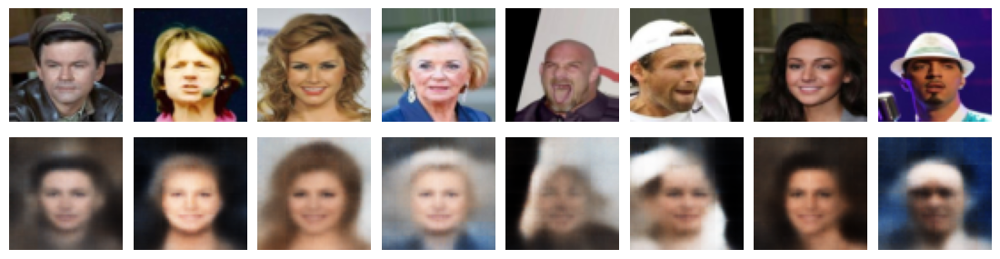

FID: 1009.170
1500/1500 [==============================] - 61s 41ms/step - batch: 749.5000 - size: 64.0000 - loss: 178.8720 - r_loss: 0.0124 - kl_loss: 54.8740
Epoch 23/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 63.9833 - loss: 178.2529 - r_loss: 0.0123 - kl_loss: 54.8570

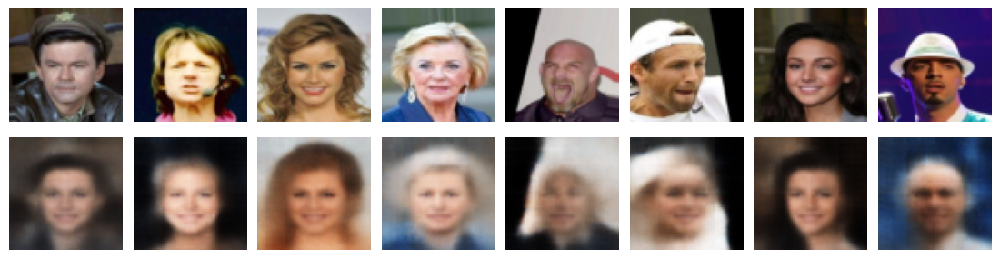

FID: 1030.733
1500/1500 [==============================] - 63s 42ms/step - batch: 749.5000 - size: 63.9833 - loss: 178.2529 - r_loss: 0.0123 - kl_loss: 54.8570
Epoch 24/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 64.0000 - loss: 178.1468 - r_loss: 0.0123 - kl_loss: 54.9527

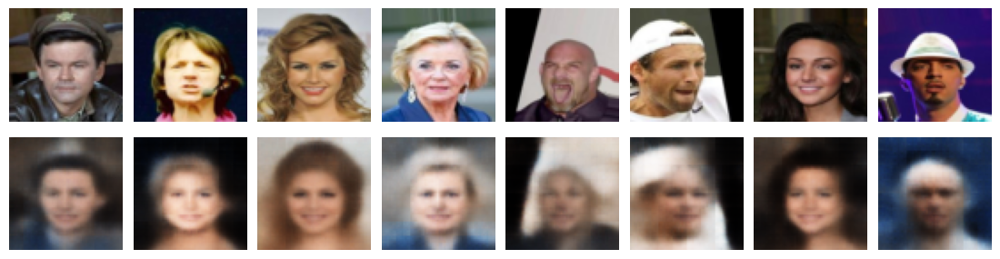

FID: 1003.657
1500/1500 [==============================] - 61s 41ms/step - batch: 749.5000 - size: 64.0000 - loss: 178.1468 - r_loss: 0.0123 - kl_loss: 54.9527
Epoch 25/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 63.9833 - loss: 177.8487 - r_loss: 0.0123 - kl_loss: 55.0396

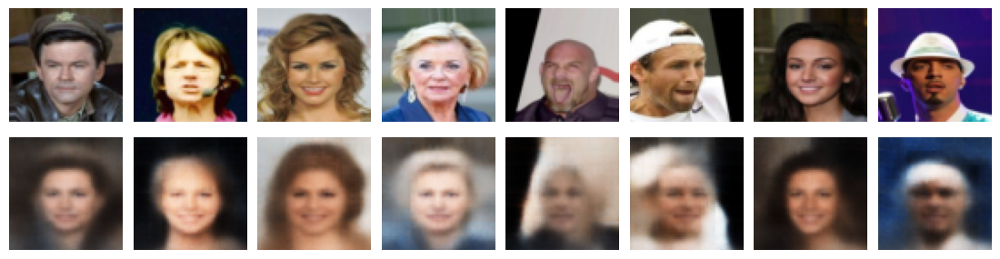

FID: 1019.550
1500/1500 [==============================] - 63s 42ms/step - batch: 749.5000 - size: 63.9833 - loss: 177.8487 - r_loss: 0.0123 - kl_loss: 55.0396
Epoch 26/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 64.0000 - loss: 177.9415 - r_loss: 0.0123 - kl_loss: 55.1477

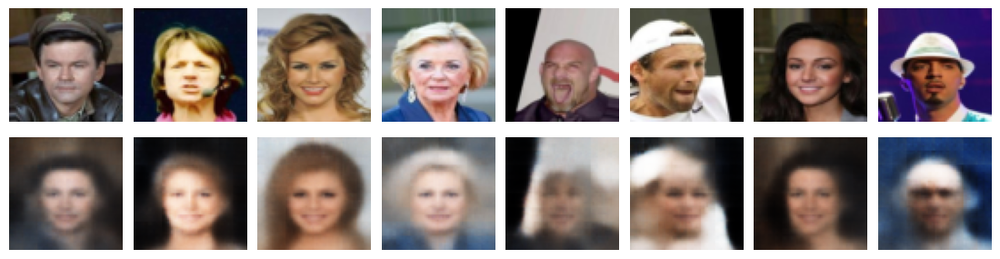

FID: 1020.464
1500/1500 [==============================] - 62s 42ms/step - batch: 749.5000 - size: 64.0000 - loss: 177.9415 - r_loss: 0.0123 - kl_loss: 55.1477
Epoch 27/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 64.0000 - loss: 177.2279 - r_loss: 0.0122 - kl_loss: 55.1417

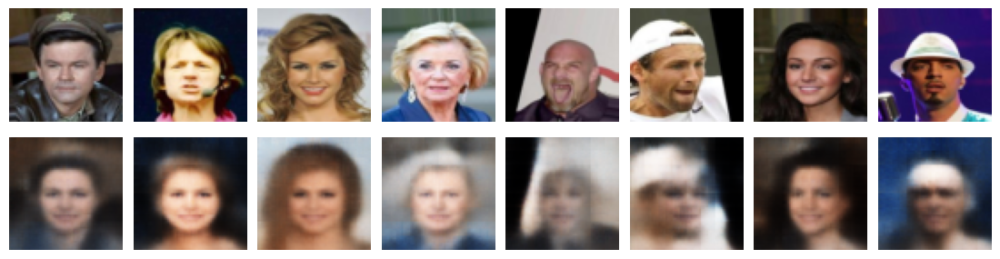

FID: 1036.023
1500/1500 [==============================] - 63s 42ms/step - batch: 749.5000 - size: 64.0000 - loss: 177.2297 - r_loss: 0.0122 - kl_loss: 55.1413
Epoch 28/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 63.9833 - loss: 177.0177 - r_loss: 0.0122 - kl_loss: 55.1625

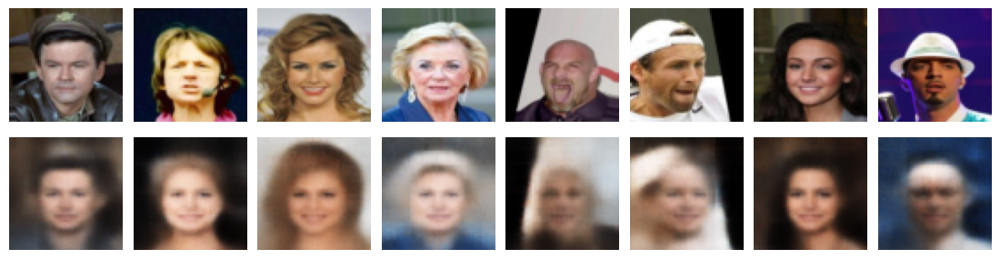

FID: 1028.702
1500/1500 [==============================] - 62s 41ms/step - batch: 749.5000 - size: 63.9833 - loss: 177.0275 - r_loss: 0.0122 - kl_loss: 55.1651
Epoch 29/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 63.9833 - loss: 176.8108 - r_loss: 0.0122 - kl_loss: 55.1998

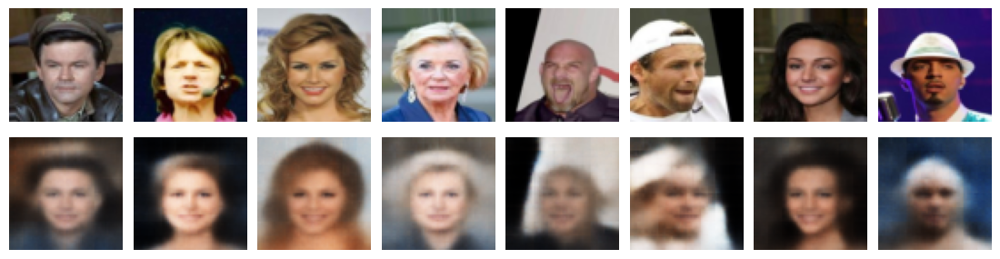

FID: 1014.475
1500/1500 [==============================] - 64s 42ms/step - batch: 749.5000 - size: 63.9833 - loss: 176.8049 - r_loss: 0.0122 - kl_loss: 55.2000
Epoch 30/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 64.0000 - loss: 176.9316 - r_loss: 0.0122 - kl_loss: 55.3566

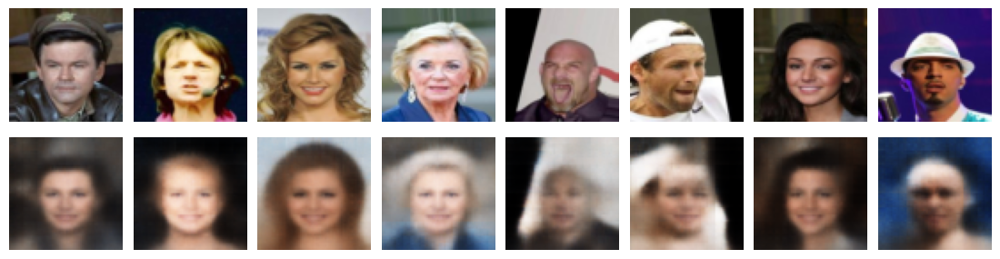

FID: 996.225
1500/1500 [==============================] - 64s 43ms/step - batch: 749.5000 - size: 64.0000 - loss: 176.9292 - r_loss: 0.0122 - kl_loss: 55.3573
Epoch 31/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 64.0000 - loss: 176.3959 - r_loss: 0.0121 - kl_loss: 55.3253

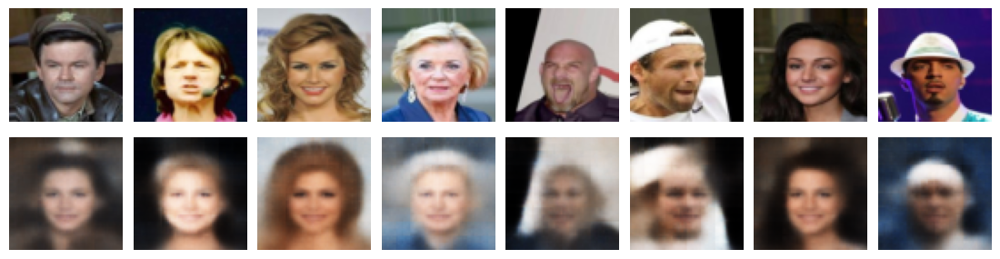

FID: 1007.948
1500/1500 [==============================] - 64s 42ms/step - batch: 749.5000 - size: 64.0000 - loss: 176.3936 - r_loss: 0.0121 - kl_loss: 55.3234
Epoch 32/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 63.9833 - loss: 176.1859 - r_loss: 0.0121 - kl_loss: 55.3438

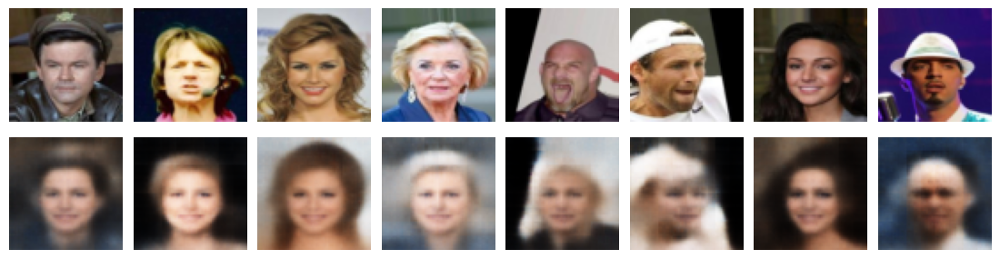

FID: 1009.178
1500/1500 [==============================] - 64s 43ms/step - batch: 749.5000 - size: 63.9833 - loss: 176.1859 - r_loss: 0.0121 - kl_loss: 55.3438
Epoch 33/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 63.9833 - loss: 176.1096 - r_loss: 0.0121 - kl_loss: 55.3764

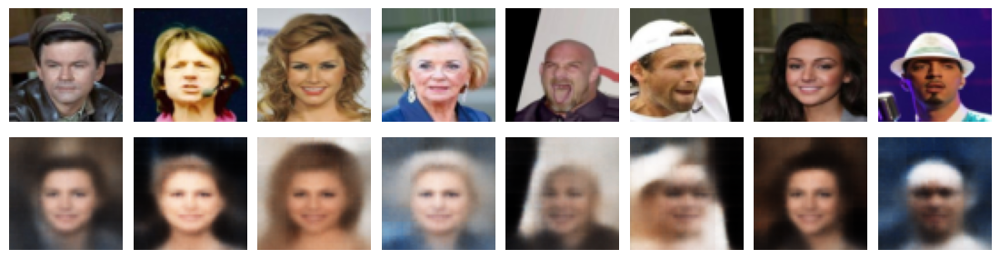

FID: 982.727
1500/1500 [==============================] - 63s 42ms/step - batch: 749.5000 - size: 63.9833 - loss: 176.1065 - r_loss: 0.0121 - kl_loss: 55.3750
Epoch 34/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 64.0000 - loss: 176.0337 - r_loss: 0.0121 - kl_loss: 55.4204

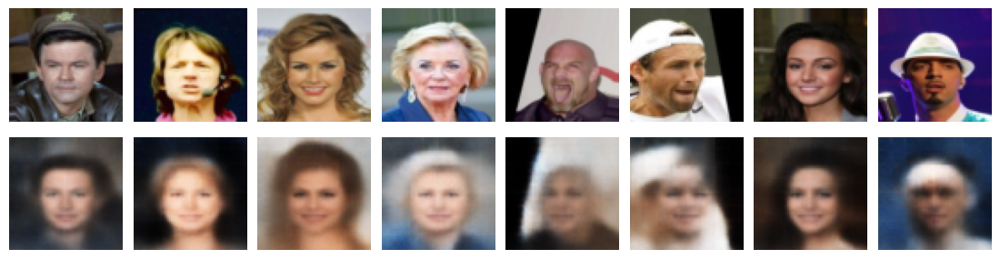

FID: 1018.762
1500/1500 [==============================] - 63s 42ms/step - batch: 749.5000 - size: 64.0000 - loss: 176.0296 - r_loss: 0.0121 - kl_loss: 55.4197
Epoch 35/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 64.0000 - loss: 175.9952 - r_loss: 0.0120 - kl_loss: 55.5442

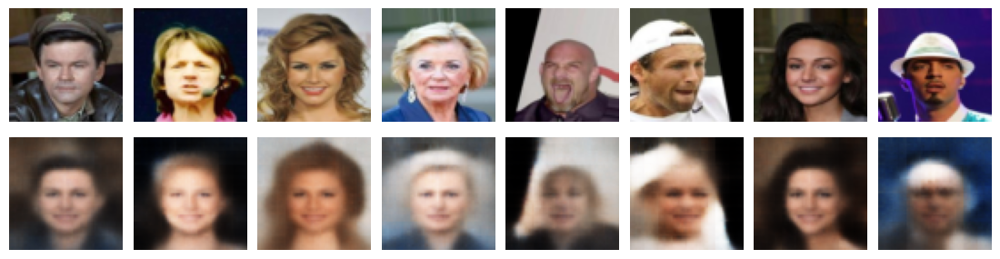

FID: 1027.607
1500/1500 [==============================] - 62s 41ms/step - batch: 749.5000 - size: 64.0000 - loss: 175.9956 - r_loss: 0.0120 - kl_loss: 55.5445
Epoch 36/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 63.9833 - loss: 175.6064 - r_loss: 0.0120 - kl_loss: 55.4210

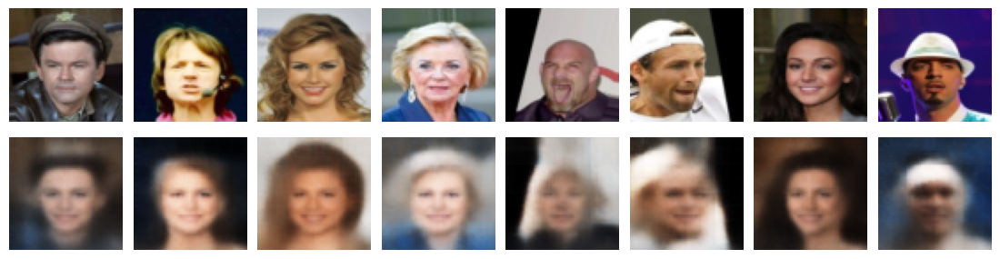

FID: 1008.398
1500/1500 [==============================] - 62s 41ms/step - batch: 749.5000 - size: 63.9833 - loss: 175.6064 - r_loss: 0.0120 - kl_loss: 55.4210
Epoch 37/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 63.9833 - loss: 175.0212 - r_loss: 0.0120 - kl_loss: 55.4147

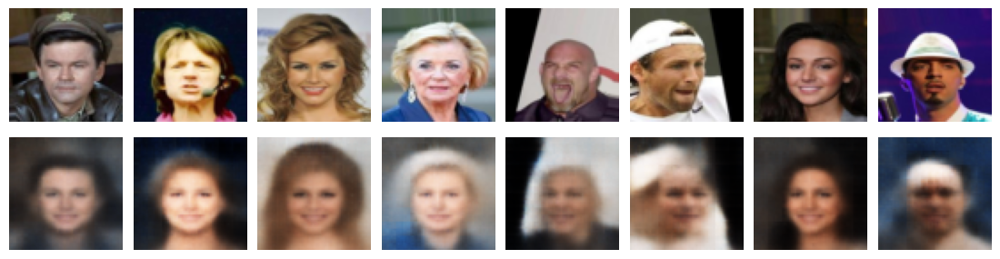

FID: 1010.843
1500/1500 [==============================] - 63s 42ms/step - batch: 749.5000 - size: 63.9833 - loss: 175.0179 - r_loss: 0.0120 - kl_loss: 55.4144
Epoch 38/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 64.0000 - loss: 175.5118 - r_loss: 0.0120 - kl_loss: 55.5329

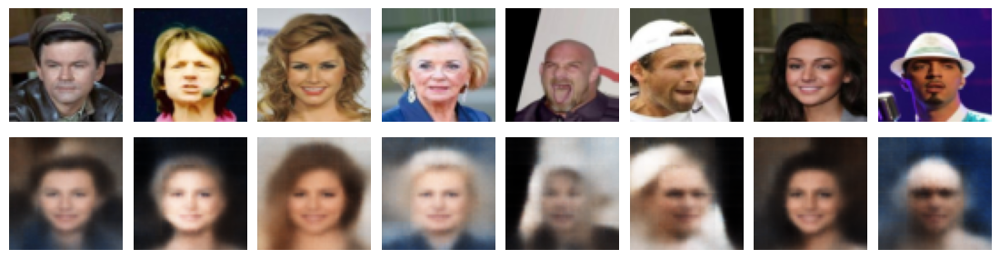

FID: 979.159
1500/1500 [==============================] - 62s 41ms/step - batch: 749.5000 - size: 64.0000 - loss: 175.5079 - r_loss: 0.0120 - kl_loss: 55.5311
Epoch 39/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 63.9833 - loss: 175.0491 - r_loss: 0.0120 - kl_loss: 55.5422

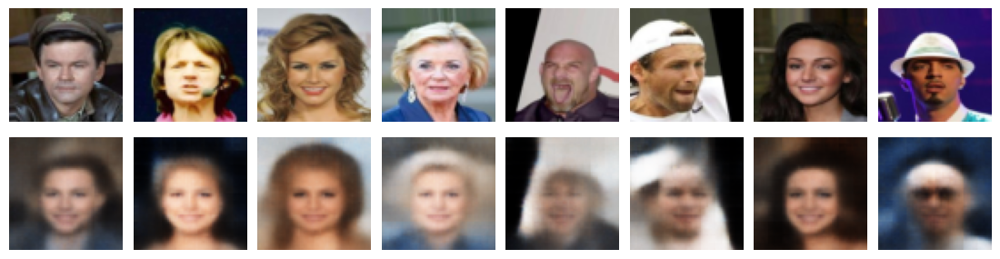

FID: 1042.339
1500/1500 [==============================] - 64s 42ms/step - batch: 749.5000 - size: 63.9833 - loss: 175.0491 - r_loss: 0.0120 - kl_loss: 55.5422
Epoch 40/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 64.0000 - loss: 174.9953 - r_loss: 0.0119 - kl_loss: 55.5317

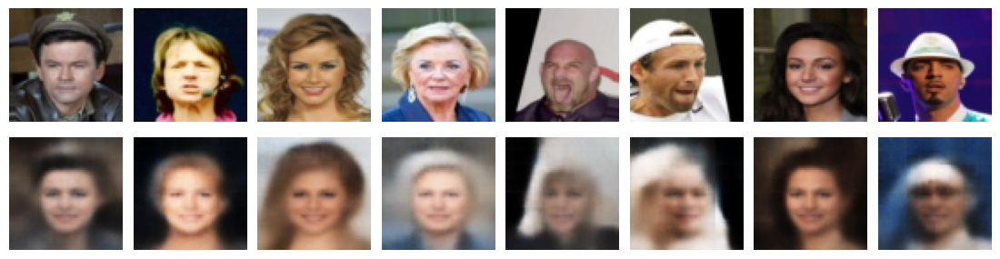

FID: 998.672
1500/1500 [==============================] - 61s 41ms/step - batch: 749.5000 - size: 64.0000 - loss: 174.9912 - r_loss: 0.0119 - kl_loss: 55.5308
Epoch 41/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 64.0000 - loss: 174.9062 - r_loss: 0.0119 - kl_loss: 55.5555

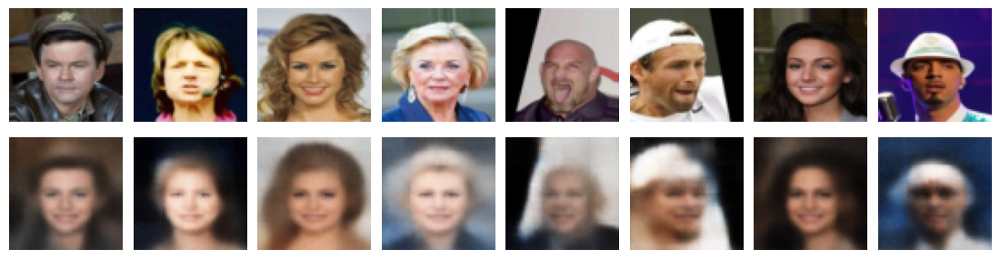

FID: 981.547
1500/1500 [==============================] - 61s 41ms/step - batch: 749.5000 - size: 64.0000 - loss: 174.9097 - r_loss: 0.0119 - kl_loss: 55.5559
Epoch 42/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 63.9833 - loss: 174.8852 - r_loss: 0.0119 - kl_loss: 55.6175

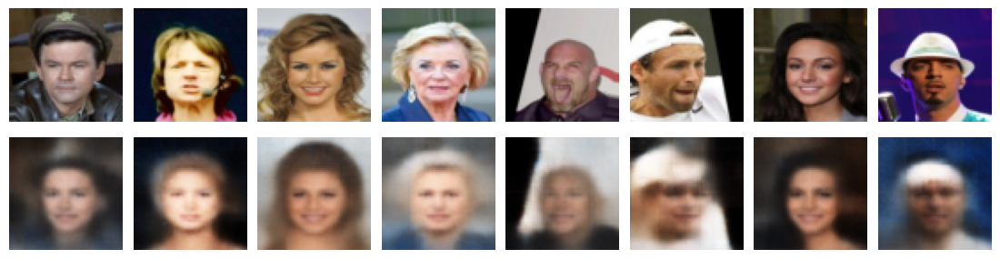

FID: 1020.127
1500/1500 [==============================] - 61s 41ms/step - batch: 749.5000 - size: 63.9833 - loss: 174.8853 - r_loss: 0.0119 - kl_loss: 55.6175
Epoch 43/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 64.0000 - loss: 174.6026 - r_loss: 0.0119 - kl_loss: 55.7031

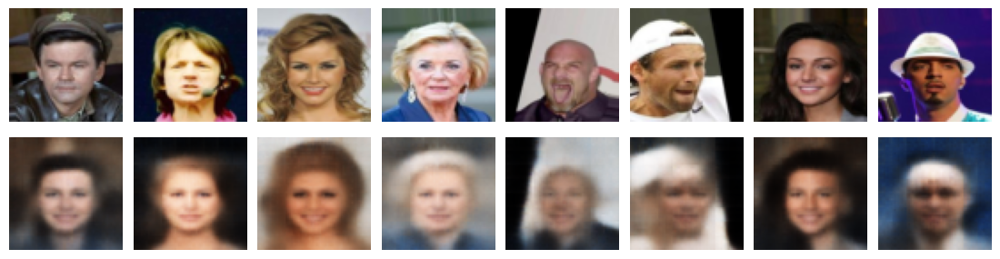

FID: 1015.714
1500/1500 [==============================] - 61s 41ms/step - batch: 749.5000 - size: 64.0000 - loss: 174.6026 - r_loss: 0.0119 - kl_loss: 55.7031
Epoch 44/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 64.0000 - loss: 174.6007 - r_loss: 0.0119 - kl_loss: 55.6271

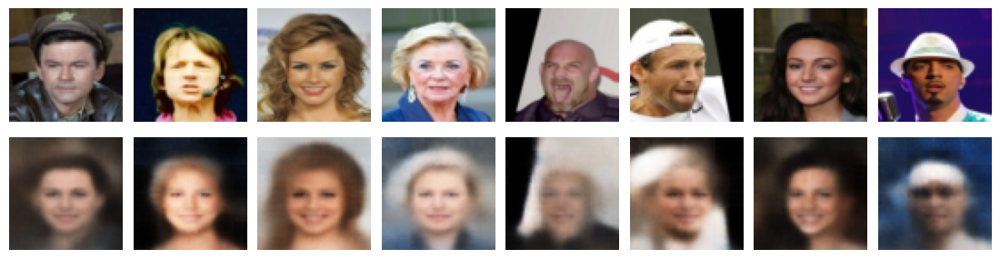

FID: 998.358
1500/1500 [==============================] - 64s 42ms/step - batch: 749.5000 - size: 64.0000 - loss: 174.6007 - r_loss: 0.0119 - kl_loss: 55.6271
Epoch 45/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 63.9666 - loss: 174.5676 - r_loss: 0.0119 - kl_loss: 55.7143

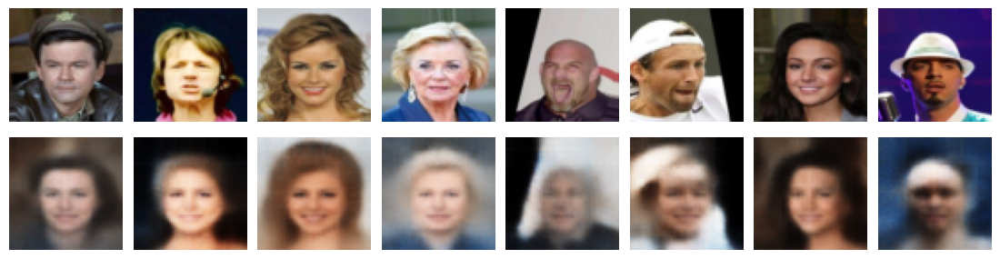

FID: 1028.736
1500/1500 [==============================] - 62s 42ms/step - batch: 749.5000 - size: 63.9667 - loss: 174.5680 - r_loss: 0.0119 - kl_loss: 55.7145
Epoch 46/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 64.0000 - loss: 174.1959 - r_loss: 0.0119 - kl_loss: 55.6365

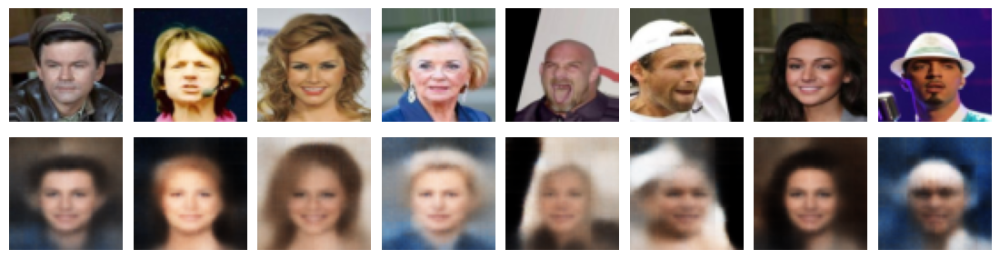

FID: 988.089
1500/1500 [==============================] - 63s 42ms/step - batch: 749.5000 - size: 64.0000 - loss: 174.1959 - r_loss: 0.0119 - kl_loss: 55.6365
Epoch 47/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 64.0000 - loss: 174.1758 - r_loss: 0.0118 - kl_loss: 55.6863

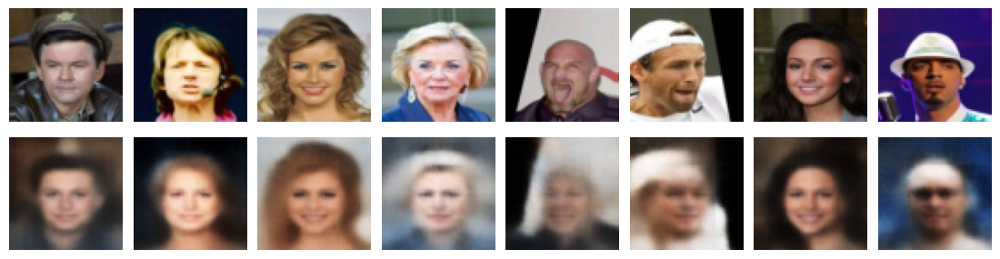

FID: 998.419
1500/1500 [==============================] - 63s 42ms/step - batch: 749.5000 - size: 64.0000 - loss: 174.1761 - r_loss: 0.0118 - kl_loss: 55.6866
Epoch 48/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 63.9833 - loss: 174.1345 - r_loss: 0.0118 - kl_loss: 55.7779

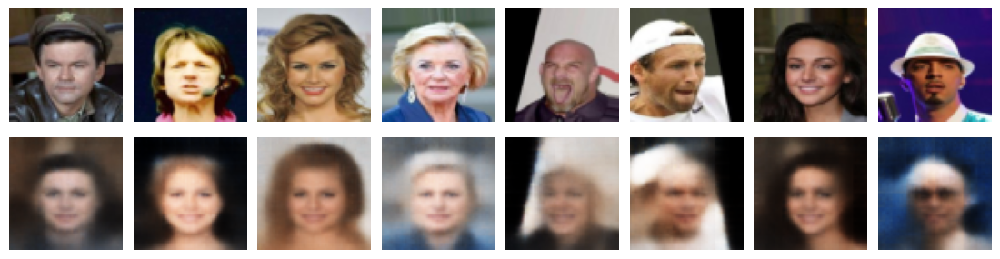

FID: 1032.483
1500/1500 [==============================] - 62s 41ms/step - batch: 749.5000 - size: 63.9833 - loss: 174.1345 - r_loss: 0.0118 - kl_loss: 55.7779
Epoch 49/50
1500/1500 [==============================] - ETA: 0s - batch: 749.5000 - size: 64.0000 - loss: 174.0054 - r_loss: 0.0118 - kl_loss: 55.7445

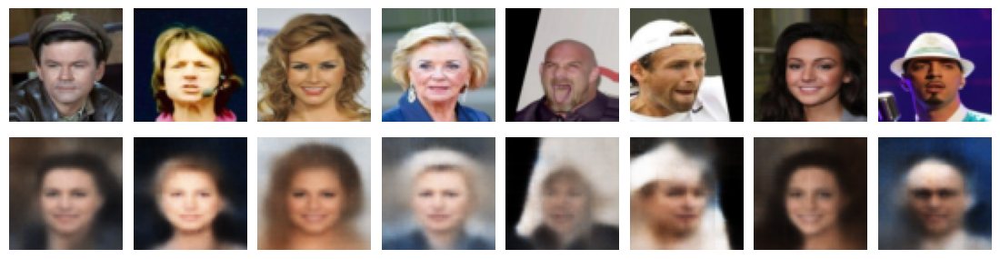

FID: 986.455
1500/1500 [==============================] - 63s 42ms/step - batch: 749.5000 - size: 64.0000 - loss: 174.0054 - r_loss: 0.0118 - kl_loss: 55.7445
Epoch 50/50
1499/1500 [============================>.] - ETA: 0s - batch: 749.0000 - size: 63.9833 - loss: 173.8628 - r_loss: 0.0118 - kl_loss: 55.7879

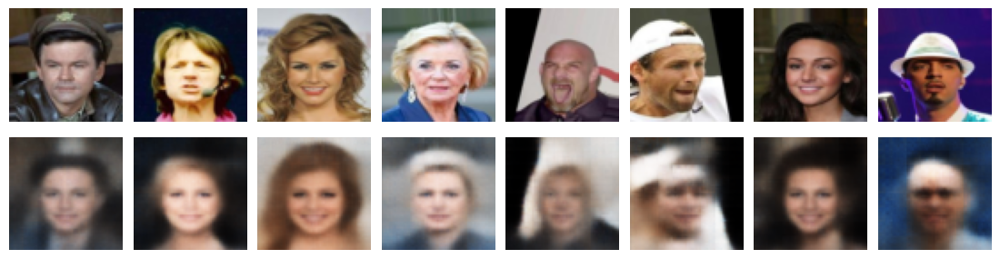

FID: 1009.477
1500/1500 [==============================] - 62s 41ms/step - batch: 749.5000 - size: 63.9833 - loss: 173.8591 - r_loss: 0.0118 - kl_loss: 55.7873


In [ ]:
###################
# Training Params
###################

LEARNING_RATE = 0.0002
N_EPOCHS = 50
STEPS_PER_EPOCH = 1500 #NUM_IMAGES / BATCH_SIZE
adam_optimizer = Adam(learning_rate=LEARNING_RATE)

############
# Callbacks
############

batch = next(data_flow)
fid_calculator = FIDCalculator(vae_decoder, batch[0], Z_DIM)
image_generator_callback = ImageGenerator(data_samples_examples, vae_encoder, vae_decoder)

#########
# Train 
#########

vae.compile(optimizer=adam_optimizer, loss=total_loss, metrics=[r_loss, kl_loss])
history = vae.fit(data_flow, shuffle=True, epochs=N_EPOCHS, initial_epoch=0, steps_per_epoch=STEPS_PER_EPOCH, callbacks=[image_generator_callback, model_checkpoint_callback, fid_calculator])    
history = history.history

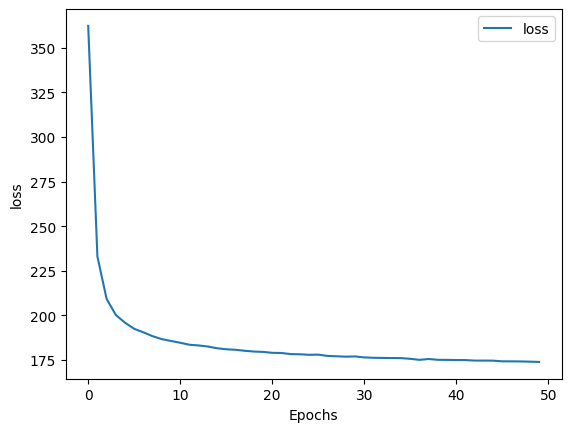

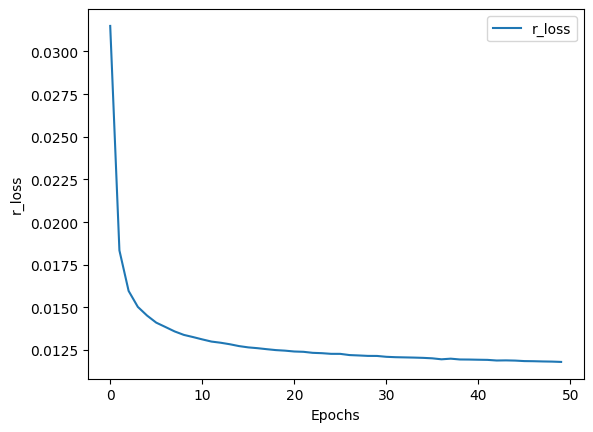

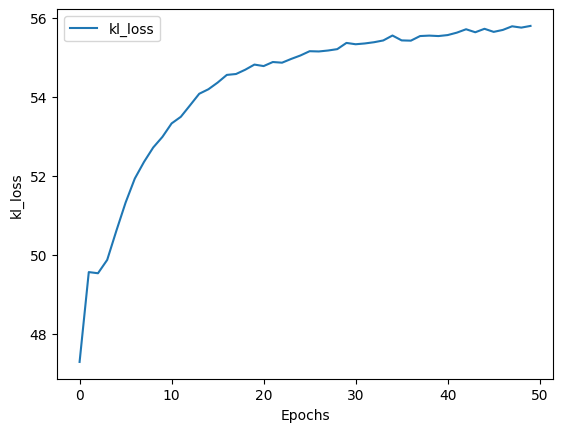

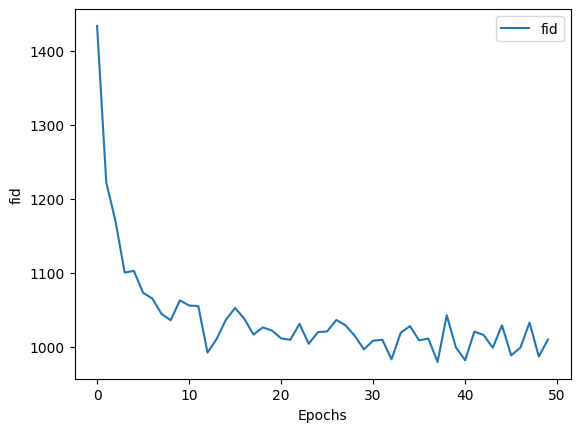

In [ ]:
history["fid"] = fid_calculator.log
plot_metrics(history)

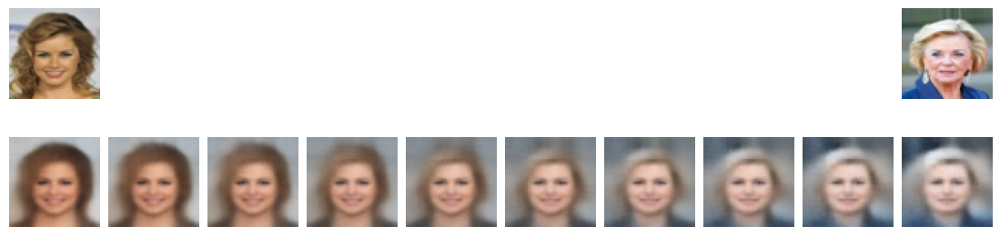

In [ ]:
linear_interpolation(data_samples_examples[2],data_samples_examples[3], vae_encoder, vae_decoder)

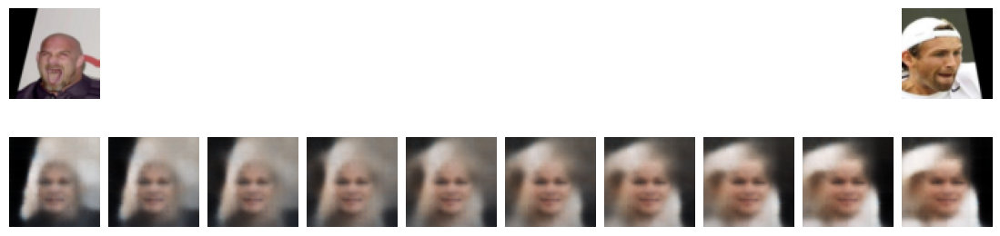

In [ ]:
linear_interpolation(data_samples_examples[4],data_samples_examples[5], vae_encoder, vae_decoder)

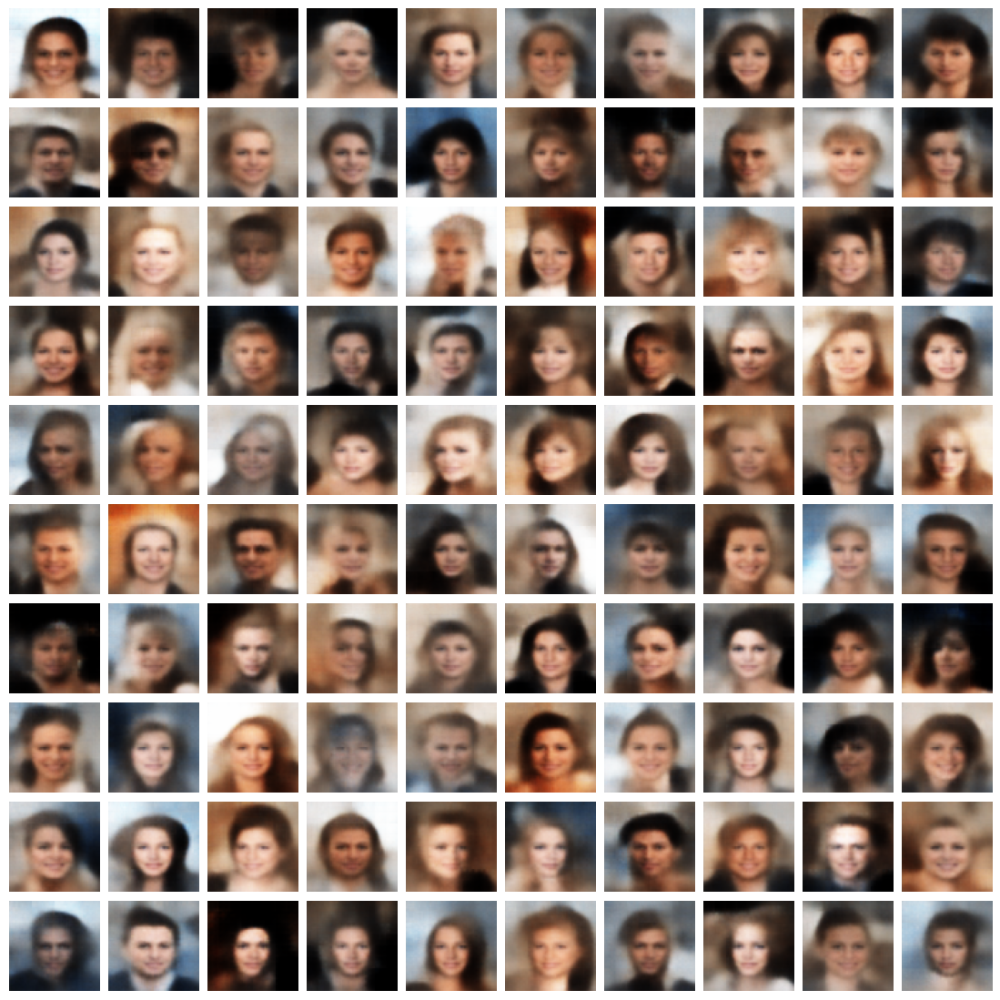

In [ ]:
plot_generated(vae_decoder, Z_DIM)

# 4. Comparative Analysis and Reporting

## Results

First of all, the context of the runs must be taken into account, i.e., the amount of work must be adapted to a practice of a subject. Also, no additional computational resources have been provided, having to be adapted to the students' resources and the dataset to be used is relatively small. Therefore, it is not expected to obtain high quality results using complex architectures, the objective being clearly educational.

Starting with the results, from the point of view of reconstruction, although most of the faces as such regenerate with certain fidelity (there are situations in which they do not, confusing faces with glasses or genders), the details surrounding them such as hair or poses are highly blurred and in poor agreement with the rest of the image.

For the images generated by taking a random point of the latent space, a similar behavior happens, being the faces of a fairly high quality, but the rest of the image is highly blurred and with some artifact. This is probably caused by the constancy in the pixel distribution for a face, but the high variability for the rest of the elements depending on the image.

Regarding the comparison between experiments, it should be noted the acceptable performance for both runs, as well as the clear and similar convergence. For the first one, the low output size means that qualitatively the results do not look as good as for the second model. In addition, the FID metric is not considered to be fully representative of the quality of the generations. In this case, when rescaling to 75x75 images for the InceptionV3 layer computation, the differences between distributions will be lower if we start from smaller images where the smoothing is more noticeable in the rescaling. Note that this fact will also happen with the GANS, making it impossible to compare models based on this metric.

If this metric is only taken into account for images of the same size (in this case, for each run), it can be seen how this metric reflects in a certain way the quality of the generated images. In fact, there comes a point where the models do not manage to exceed certain ranges, due to the limited capacity of the models and the limited data available.

As for the difference in performance between models, it is considered to be even (not taking into account the clearly superior level of detail of the second model), compensating the increase in resolution with the complexity of the network and the latent space.

Finally, it should be noted that a training identical to the 2nd model but in grayscale has been tested. This one has been deleted for reasons of simplicity as the results were practically identical to the identical run but with color.

## Comparison with GANs

The comparison with the GANs will be found in the GANs Notebook, avoiding duplication of content.